# Tabel of Contents

# Contents

## Imports

In [41]:
import missingno as msno
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from EDA_functions import *

## EDA

I like to start EDA with:

  1. Initial tips (understand each column and get an overview (df.info()), statistical summary (df.describe()))
  2. Identify Missing Data
  3. Check Intermittency
  4. Detect Outliers
  5. Visual Exploration
  6. Conclusions


### 1. Initial tips

In [5]:
energy_data_ = pd.read_csv('../data/raw/energy_dataset.csv', parse_dates=['time'])
display(energy_data_.head(3))

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2015-01-01 00:00:00+01:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 01:00:00+01:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 02:00:00+01:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48


In [6]:
# Convert to timestamp
energy_data_['time'] = pd.to_datetime(energy_data_['time'], utc=True)
energy_data_.set_index('time', inplace=True)
display(energy_data_.head(3))

,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
time,,,,,,,,,,,,,,,,,,,,,
2014-12-31 23:00:00+00:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,NaN,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
2015-01-01 00:00:00+00:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,NaN,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2015-01-01 01:00:00+00:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,NaN,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48


#### Initial tips: Analysis

In [14]:
def simple_eda(df):
  """
  Function to print all initial tips (step 1 in EDA)
  """
  display(df.head())
  display(df.describe().round(2).T)
  display(df.info())
  print(f'DataFrame shape: {df.shape}')
  print(f'Number duplicated rows: {len(df[df.duplicated()])}')
  
simple_eda(energy_data_)

,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
time,,,,,,,,,,,,,,,,,,,,,
2014-12-31 23:00:00+00:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,NaN,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
2015-01-01 00:00:00+00:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,NaN,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2015-01-01 01:00:00+00:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,NaN,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
2015-01-01 02:00:00+00:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,NaN,...,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
2015-01-01 03:00:00+00:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,NaN,...,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04


,count,mean,std,min,25%,50%,75%,max
generation biomass,35045.0,383.51,85.35,0.00,333.00,367.00,433.00,592.00
generation fossil brown coal/lignite,35046.0,448.06,354.57,0.00,0.00,509.00,757.00,999.00
generation fossil coal-derived gas,35046.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00
generation fossil gas,35046.0,5622.74,2201.83,0.00,4126.00,4969.00,6429.00,20034.00
generation fossil hard coal,35046.0,4256.07,1961.60,0.00,2527.00,4474.00,5838.75,8359.00
generation fossil oil,35045.0,298.32,52.52,0.00,263.00,300.00,330.00,449.00
generation fossil oil shale,35046.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00
generation fossil peat,35046.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00
generation geothermal,35046.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00
generation hydro pumped storage aggregated,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 35064 entries, 2014-12-31 23:00:00+00:00 to 2018-12-31 22:00:00+00:00
Data columns (total 28 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   generation biomass                           35045 non-null  float64
 1   generation fossil brown coal/lignite         35046 non-null  float64
 2   generation fossil coal-derived gas           35046 non-null  float64
 3   generation fossil gas                        35046 non-null  float64
 4   generation fossil hard coal                  35046 non-null  float64
 5   generation fossil oil                        35045 non-null  float64
 6   generation fossil oil shale                  35046 non-null  float64
 7   generation fossil peat                       35046 non-null  float64
 8   generation geothermal                        35046 non-null  float64
 9   generation hydro pumped s

None

DataFrame shape: (35064, 28)
Number duplicated rows: 0


#### Initial tips: Observations#1

1. no duplicated rows;
2. some columns are going to be deleted for 2 reasons:
    - does not show any information (example: 'forecast wind offshore eday ahead' column where all isntances have NaN values).
    - same value for each instance (example:'generation geothermal' column where are values are 0)
    - There is no evidence about outliers - outlier detection needs to be careful analyzed.

Next Procedure: delete non-important columns; analyze missing values and apply a data cleaning procedure.

### 2. Identify Missing Data

In [15]:
columns_to_delete = ['generation hydro pumped storage aggregated', 'forecast wind offshore eday ahead',
                     'generation fossil coal-derived gas',
                     'generation fossil oil', 'generation fossil oil shale','generation fossil peat',
                     'generation geothermal',
                     'generation marine',
                     'generation wind offshore',
                     ]

energy_data_.drop(columns=columns_to_delete, errors='ignore', inplace=True) # delete no important columns
display(energy_data_.shape)
energy_data_.head(3)

(35064, 19)

,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
time,,,,,,,,,,,,,,,,,,,
2014-12-31 23:00:00+00:00,447.0,329.0,4844.0,4821.0,863.0,1051.0,1899.0,7096.0,43.0,73.0,49.0,196.0,6378.0,17.0,6436.0,26118.0,25385.0,50.10,65.41
2015-01-01 00:00:00+00:00,449.0,328.0,5196.0,4755.0,920.0,1009.0,1658.0,7096.0,43.0,71.0,50.0,195.0,5890.0,16.0,5856.0,24934.0,24382.0,48.10,64.92
2015-01-01 01:00:00+00:00,448.0,323.0,4857.0,4581.0,1164.0,973.0,1371.0,7099.0,43.0,73.0,50.0,196.0,5461.0,8.0,5454.0,23515.0,22734.0,47.33,64.48


,0
generation biomass,19
generation fossil brown coal/lignite,18
generation fossil gas,18
generation fossil hard coal,18
generation hydro pumped storage consumption,19
generation hydro run-of-river and poundage,19
generation hydro water reservoir,18
generation nuclear,17
generation other,18
generation other renewable,18


<Axes: xlabel='time'>

<Axes: >

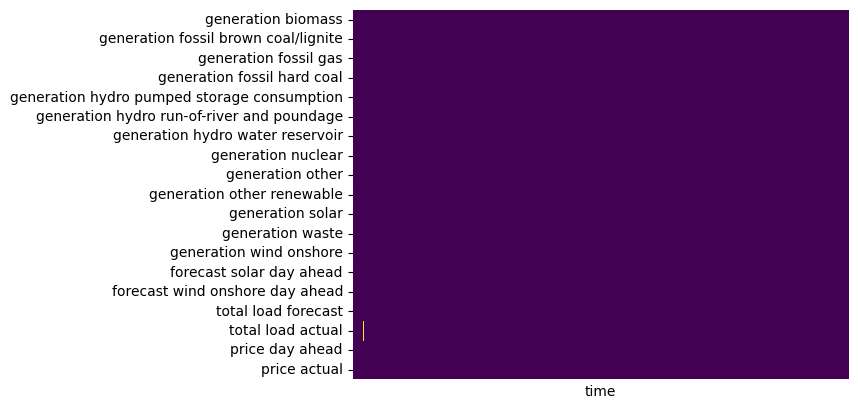

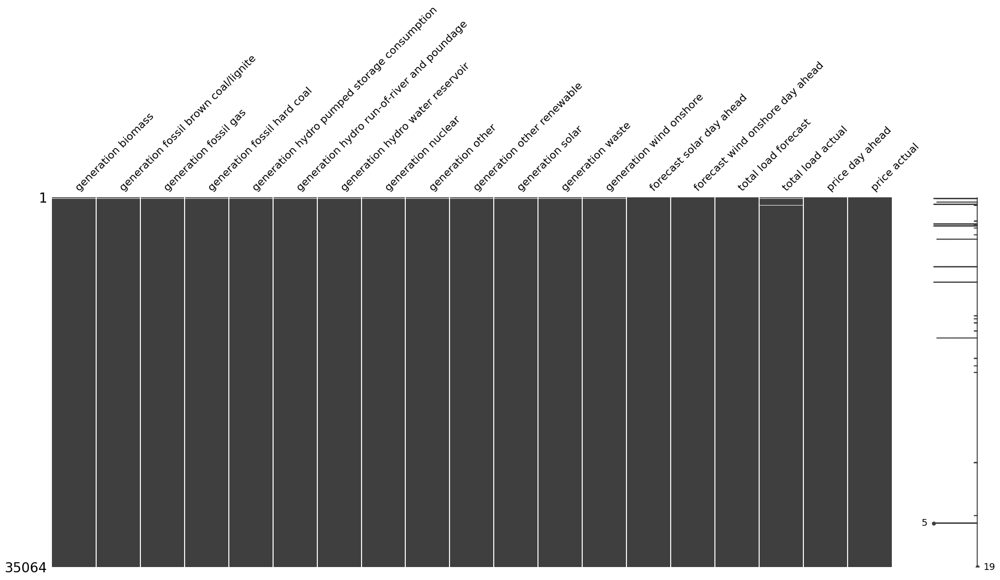

In [207]:
display(energy_data_.isnull().sum())
plt.figure()
display(sns.heatmap(energy_data_.isnull().transpose(),cbar=False, cmap='viridis', xticklabels=False))
msno.matrix(energy_data_)

In [16]:
print(f'Number of rows with nan values: {energy_data_[energy_data_.isnull().any(axis=1)].shape[0]}')
nan_rows = energy_data_[energy_data_.isnull().any(axis=1)]

display(nan_rows.groupby(nan_rows.index.date).size())
nan_rows

Number of rows with nan values: 45


2015-01-05     7
2015-01-19     2
2015-01-27     1
2015-01-28     1
2015-02-01    11
2015-04-05     1
2015-04-16     1
2015-04-20     1
2015-04-23     1
2015-05-02     1
2015-05-29     1
2015-06-15     1
2015-10-02     2
2015-12-02     1
2016-04-13     1
2016-04-25     2
2016-05-10     1
2016-06-11     1
2016-07-09     1
2016-09-28     1
2016-10-27     1
2016-11-23     1
2017-11-14     2
2018-06-11     1
2018-07-11     1
dtype: int64

,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
time,,,,,,,,,,,,,,,,,,,
2015-01-05 02:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,546.0,8233.0,21912.0,21182.0,35.20,59.68
2015-01-05 11:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3932.0,9258.0,23209.0,NaN,35.50,79.14
2015-01-05 12:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4236.0,9156.0,23725.0,NaN,36.80,73.95
2015-01-05 13:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4215.0,9072.0,23614.0,NaN,32.50,71.93
2015-01-05 14:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4050.0,8779.0,22381.0,NaN,30.00,71.50
2015-01-05 15:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3728.0,8426.0,21371.0,NaN,30.00,71.85
2015-01-05 16:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3175.0,7946.0,20760.0,NaN,30.60,80.53
2015-01-19 18:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,91.0,6434.0,38642.0,39304.0,70.01,88.95
2015-01-19 19:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.0,6907.0,38758.0,39262.0,69.00,87.94


#### Identify Missing Values : Observations#1

  - There's some missing data: some columns show same values of nan values (only 'total load actual' feature (feature=column) has more missing data).

  - Most of the columns in this dataset are fully populated with no missing values. A few columns have some missing values. On both aprroaches missing data is not so visible since almost all points have valida data - however it's possible to observe that some missing values seems to be in same datetime.
  Note: missingno is a new library that i find out recently and it is very cool.

  - There are nan values that are 'alone' - there is just 1/2 occurences per day - for that cases a linear interpolation is going to be done.
  - there are nan values in a sequence of rows (example:2015-01-05 from 11h until 16h) - I am going to plot the data in order to see what is the best approach to apply.
  - There are only 2 dates with more than 2 missing values (2015-01-05 with 7 NaN values and 2015-02-01 with 11 missing values)



In [17]:
# 1. Apply linear interpolation in all nan values excluding 2015-01-05 and 2015-02-01 dates
nan_rows = energy_data_.isnull().any(axis=1)
display(energy_data_[energy_data_.isnull().any(axis=1)].shape)
# Create a mask for the dates that are in the dates_to_exclude
mask = (((
    energy_data_.index.date == np.datetime64('2015-02-01')) | (energy_data_.index.date == np.datetime64('2015-01-05'))
    ) & nan_rows)
energy_data_[~mask] = energy_data_[~mask].interpolate(method='linear').round(2)
display((energy_data_[energy_data_.isnull().any(axis=1)]))
display(energy_data_[energy_data_.isnull().any(axis=1)].shape)

(45, 19)

,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
time,,,,,,,,,,,,,,,,,,,
2015-01-05 02:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,546.0,8233.0,21912.0,21182.0,35.20,59.68
2015-01-05 11:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3932.0,9258.0,23209.0,NaN,35.50,79.14
2015-01-05 12:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4236.0,9156.0,23725.0,NaN,36.80,73.95
2015-01-05 13:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4215.0,9072.0,23614.0,NaN,32.50,71.93
2015-01-05 14:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4050.0,8779.0,22381.0,NaN,30.00,71.50
2015-01-05 15:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3728.0,8426.0,21371.0,NaN,30.00,71.85
2015-01-05 16:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3175.0,7946.0,20760.0,NaN,30.60,80.53
2015-02-01 06:00:00+00:00,449.0,312.0,4765.0,5269.0,480.0,980.0,1174.0,7101.0,44.0,75.0,48.0,208.0,3289.0,18.0,3141.0,24379.0,NaN,56.10,16.98
2015-02-01 07:00:00+00:00,453.0,312.0,4938.0,5652.0,0.0,1031.0,3229.0,7099.0,44.0,75.0,73.0,207.0,3102.0,63.0,3165.0,27389.0,NaN,57.69,19.56


(18, 19)

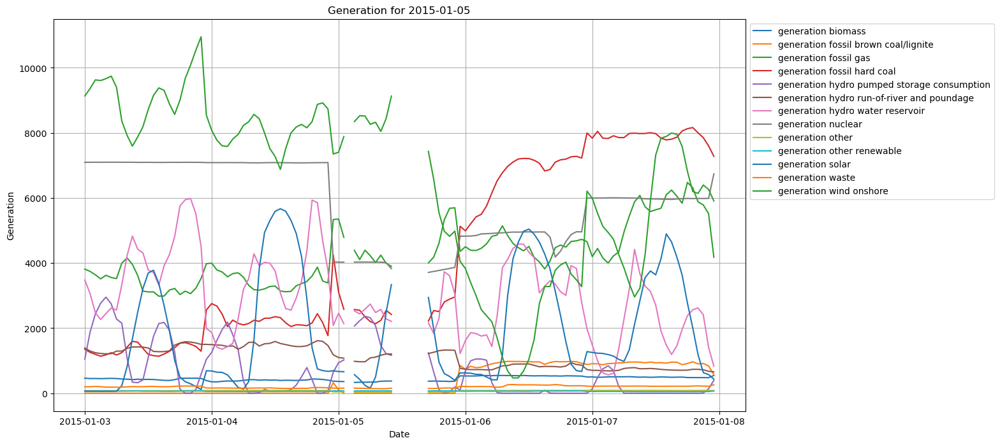

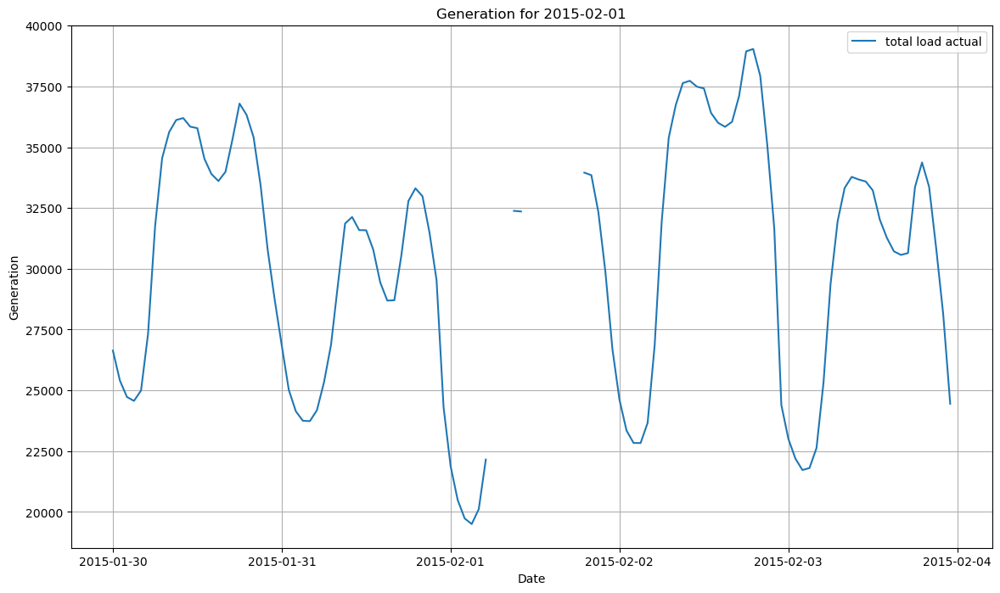

In [18]:
# Plot dates with more missing values
generation_columns = energy_data_.loc[:, energy_data_.columns.str.contains('generation')]
%matplotlib inline

plot_null_values_specific_day(generation_columns, '2015-01-05')
plot_null_values_specific_day(energy_data_, '2015-02-01')

#### Identify Missing Values : Observations#2

  - What we have  here is all 'small gaps'.

  - **2015-02-01**: all NaN values belongs to 'total actual load'.
  
  - **2015-01-05**: there's 2 different situations: there's only a small gap in timestamp '2015-01-05 02:00:00+00:00' - I am going to apply a linear interpolation. For the others timestamps (11h-16h from same day) the methods are dependent from each feature behaviour (example: 'solar generation' has a daily seasonalitty : in that case a spline/polynominal can be better than a linear interpolation).

**My usual approach**:
. Small gaps: linear interpolation, forward fill, etc.
.Large gaps:
  - no trend or seasonality: forward fill, linear interpolation, polynomial interpolation, etc.
  - strong trend and no seasonality: linear interpolation.
  - Strong seasonality: seasonal decomposition and interpolation.

**How to detect seasonality?**
  - Visual inspection
  - Decomposition is another possibility, which involves breaking the data into three components: trend, seasonality, and noise.
  - Autocorrelation (useful tool for measuring the correlation between  data and its lagged values)



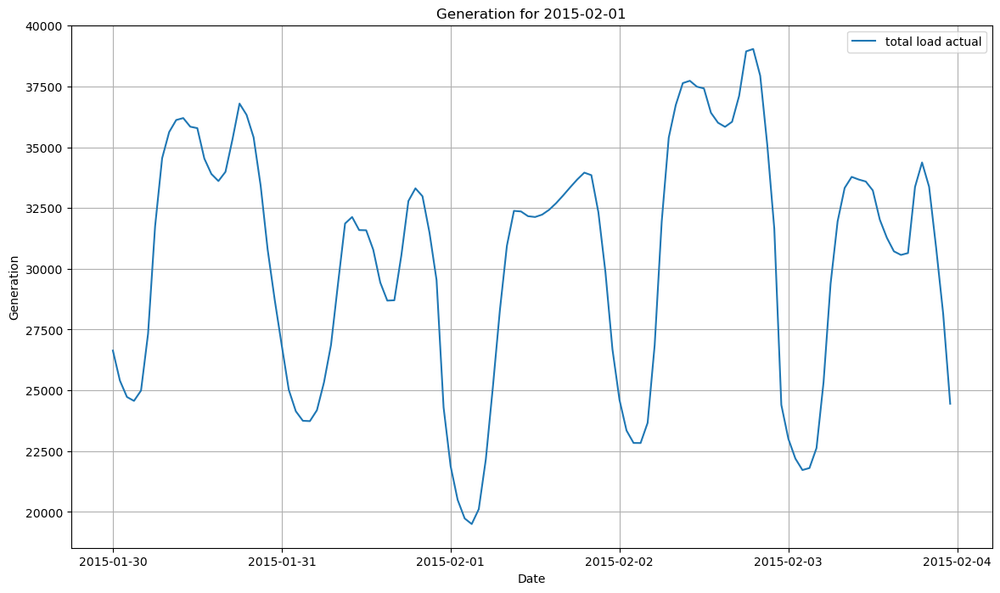

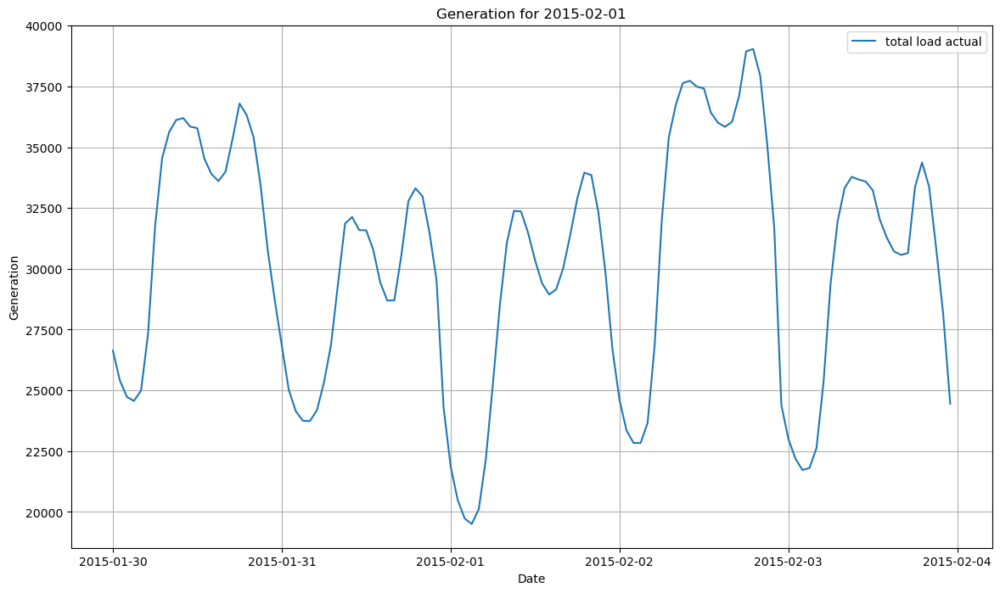

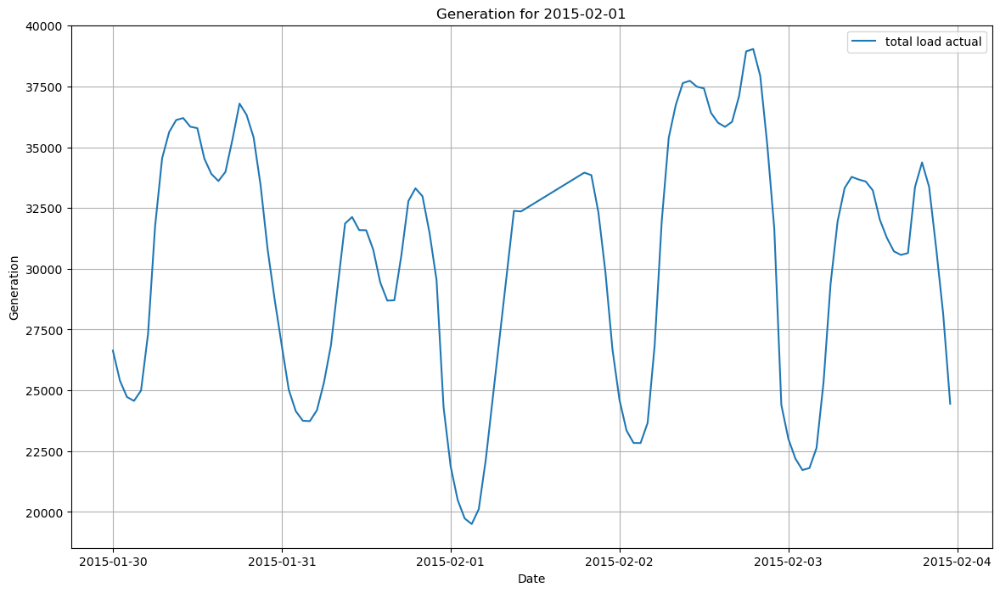

In [20]:
# Test different df.interpolate methods
a = energy_data_[['total load actual']].interpolate(method='polynomial', order=3)
b = energy_data_[['total load actual']].interpolate(method='polynomial', order=5)
c = energy_data_[['total load actual']].interpolate(method='linear')

# plot_specific_day(energy_data_.loc[:, energy_data_.columns.str.contains('generation')], '2015-01-05')
# plot_specific_day(energy_data_['total load actual'], '2015-02-01')
for method in [a,b,c]:
  plot_day(method, '2015-02-01')

In [21]:
# Fill Nan with best method
energy_data_[['total load actual']] = energy_data_[['total load actual']].interpolate(method='polynomial', order=5)


In [22]:
# Fill Nan '2015-01-05 02:00:00+00:00' timestamp
df_interpolated = energy_data_.interpolate(method='linear')
energy_data_.loc['2015-01-05 02:00:00+00:00',:] = df_interpolated.loc['2015-01-05 02:00:00+00:00',:]

#### Identify Missing Values : Observations#3
  In this analysis, I examined the daily seasonalities across all generation columns.

Key observations include:

- Between 11:00-16:00 different generation columns exhibit distinct patterns:
  
  1.Some columns display polynomial trends.
  
  2.Others follow more linear trends.
  
  3.Certain columns, while showing polynomial characteristics, can be classified as linear due to minimal production levels or a steady pattern throughout the day.

**linear behaviour columns**: 'generation wind onshore', 'generation other renewable', 'generation other','generation nuclear'.

**polynominal behaviour but depriciated (generation near 0/ seems to follow a steady pattern)**: 'geneartion biomass','generation fossil brown coal', 'generation hydro run of river'

**polynominal interpolation**: 'generation solar' , 'fossil gas', 'generation hydro pumped storage', 'fossil hard coal', 'generation hydro water', 'fossil hard coal'


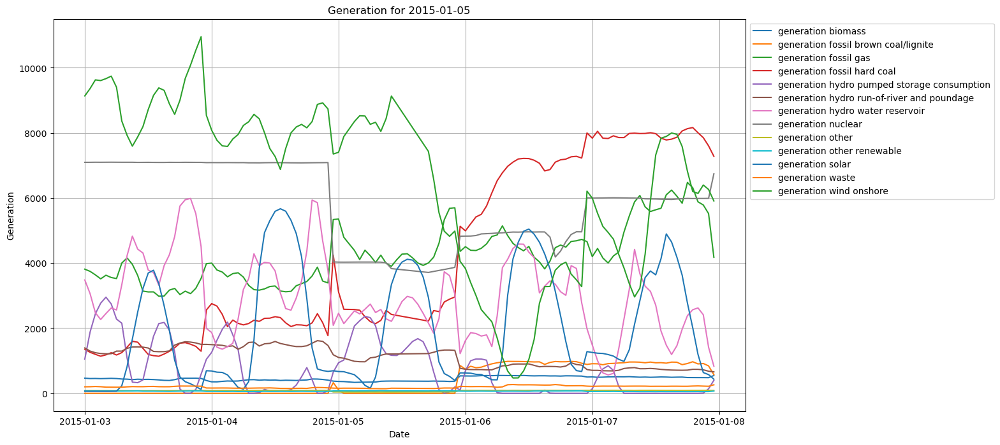

In [23]:
# Fill Nan '2015-01-05' timestamp for others rows with missing data
columns_to_apply_linear_interpolation = ['generation wind onshore', 'generation other renewable', 'generation other',
                                         'generation nuclear', 'generation biomass','generation fossil brown coal/lignite',
                                         'generation hydro run-of-river and poundage', 'generation waste', 'generation fossil hard coal']

columns_to_apply_polynominal_interpolation = ['generation solar', 'generation fossil gas', 'generation hydro pumped storage consumption',
                                              'generation hydro water reservoir']
# Apply linear interpolation
energy_data_[columns_to_apply_linear_interpolation] = energy_data_[columns_to_apply_linear_interpolation].interpolate(method='linear')
# Apply polynominal interpolation
energy_data_[columns_to_apply_polynominal_interpolation] = energy_data_[columns_to_apply_polynominal_interpolation].interpolate(method='polynomial', order=5)

plot_day(energy_data_[generation_columns.columns], '2015-01-05')

### 3. Check Intermittency

Intermittency is characterized when your data has a large number of values that are exactly zero.
Some models does not work well with sparse data.


                                             number_of_zeros  \
generation biomass                                         4   
generation fossil brown coal/lignite                   10524   
generation fossil gas                                      1   
generation fossil hard coal                                3   
generation hydro pumped storage consumption            12614   
generation hydro run-of-river and poundage                 3   
generation hydro water reservoir                           3   
generation nuclear                                         3   
generation other                                           4   
generation other renewable                                 3   
generation solar                                           3   
generation waste                                           3   
generation wind onshore                                    3   
forecast solar day ahead                                 539   
forecast wind onshore day ahead         

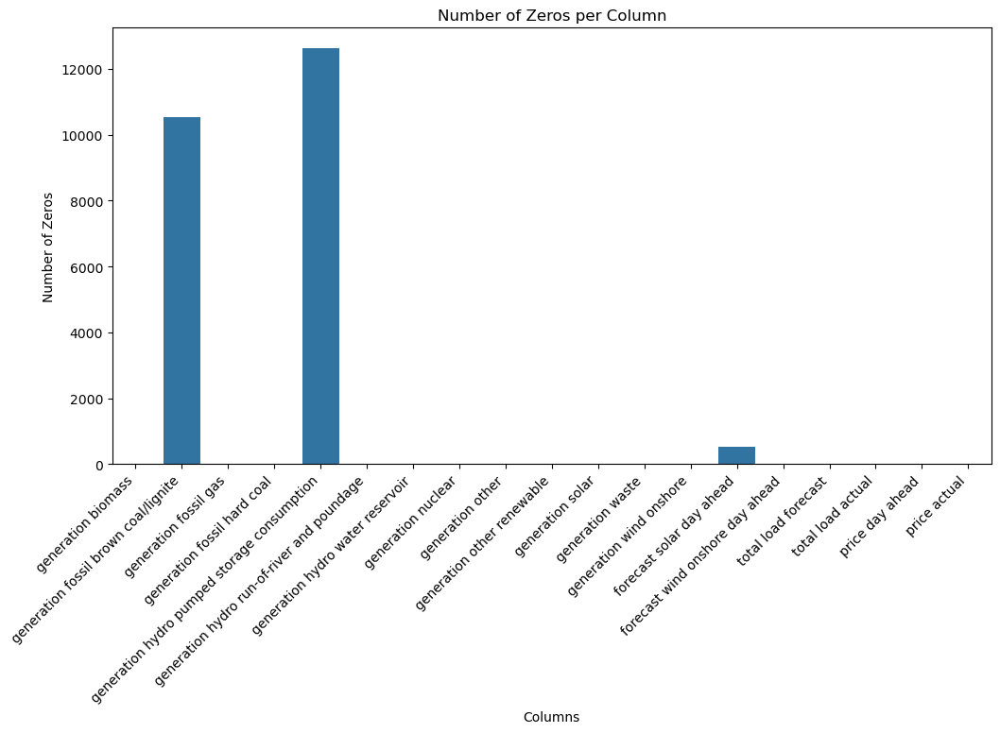

In [24]:
see_intermittency(energy_data_)


#### Check Intermittency : Observations#1

Three columns contain a significant number of zero values related to 'solar generation', 'fossil hard coal', and 'hydro pumped storage consumption'. The reasoning behind the zeros in 'solar generation' is straightforward.

Possibilities for another columns:
  - **pumped-storage hydroelectricity** functions by storing energy during low-demand periods (pumping water uphill) and generating electricity during peak demand (releasing water downhill). This method is primarily employed for grid stability.

  -**fossil hard coal**: Many countries are moving away from coal as part of the energy transition, which may result in its use being limited to maintaining grid stability.


### 4. Detect Outliers

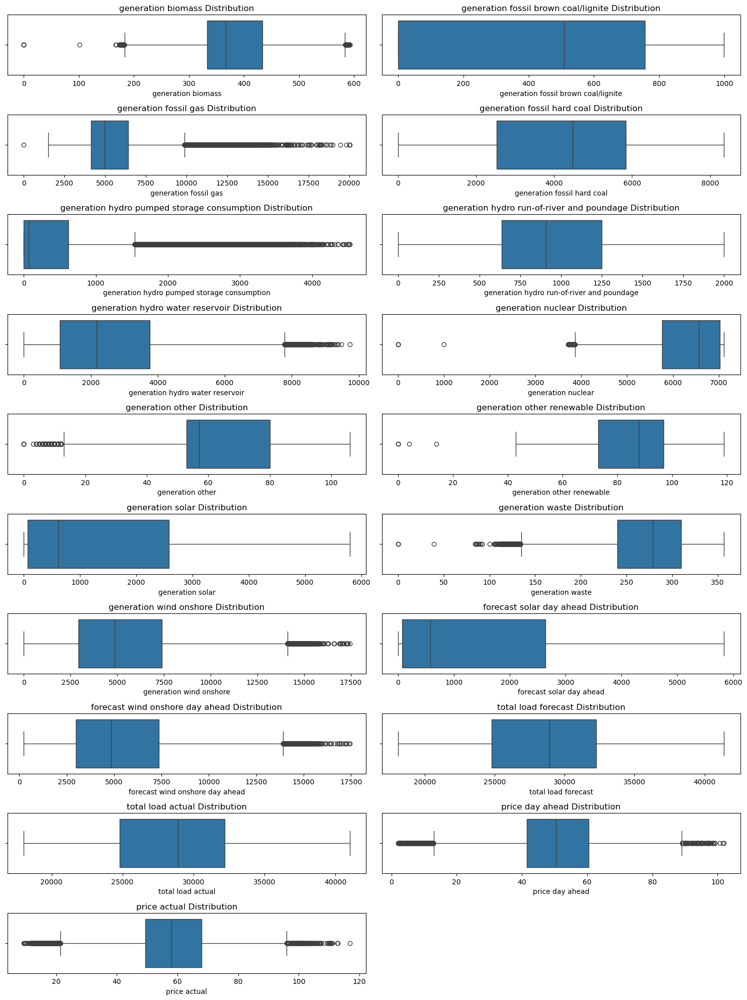

In [25]:
data_visualizations_plots(energy_data_, 'boxplot')

Number of different days with outliers: 9
2015-01-05    12
2016-02-13    22
2016-02-14    24
2016-02-15     6
2016-07-02     6
2017-03-06     5
2017-11-12     1
2017-11-14     2
2018-05-06     1
dtype: int64
Plotting data for date: 2015-01-05


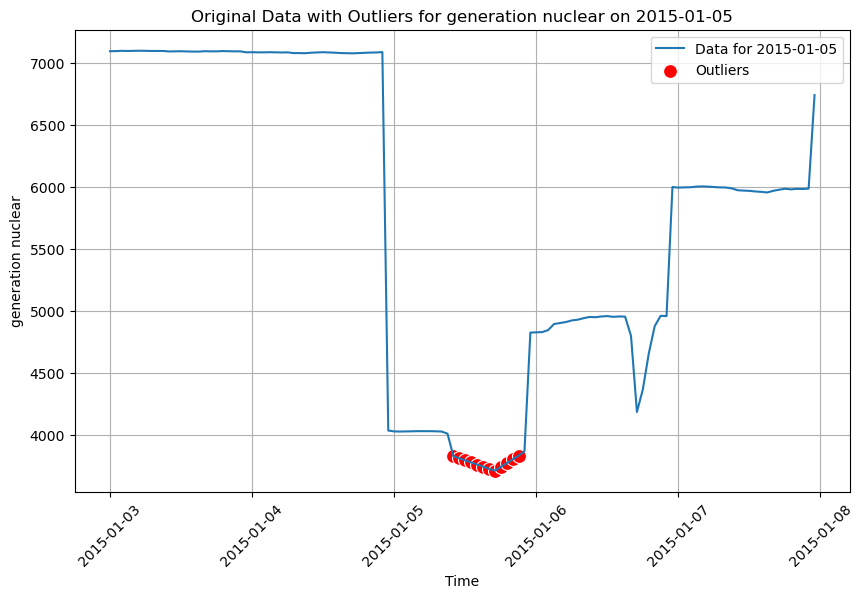

Plotting data for date: 2016-02-13


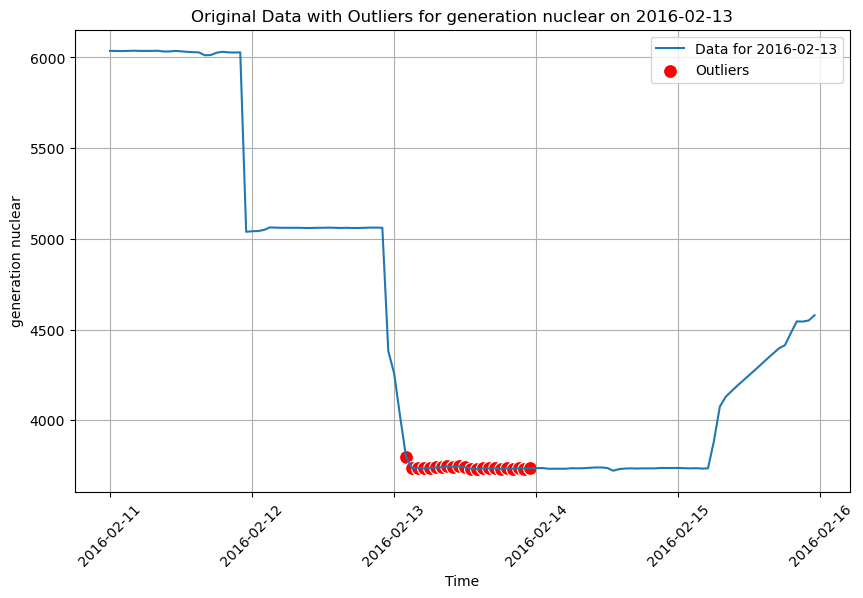

Plotting data for date: 2016-02-14


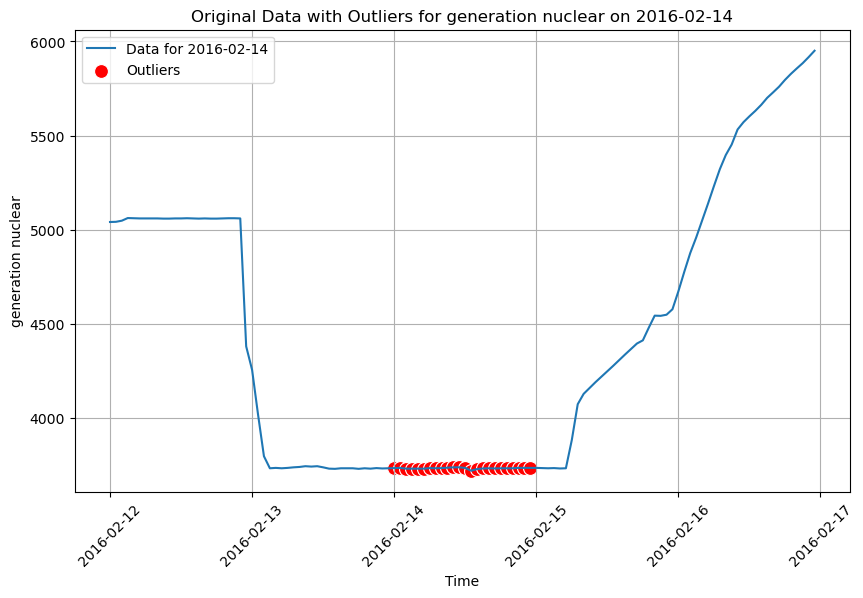

Plotting data for date: 2016-02-15


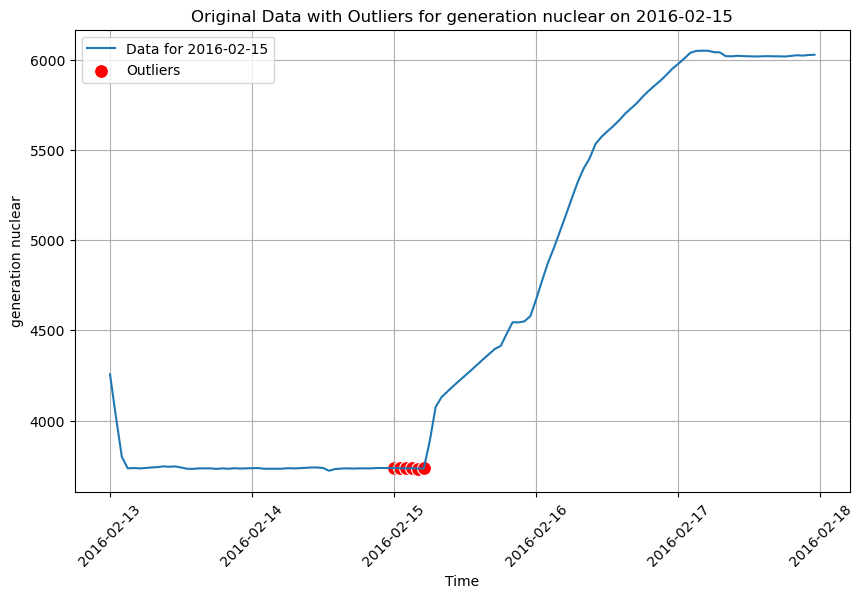

Plotting data for date: 2016-07-02


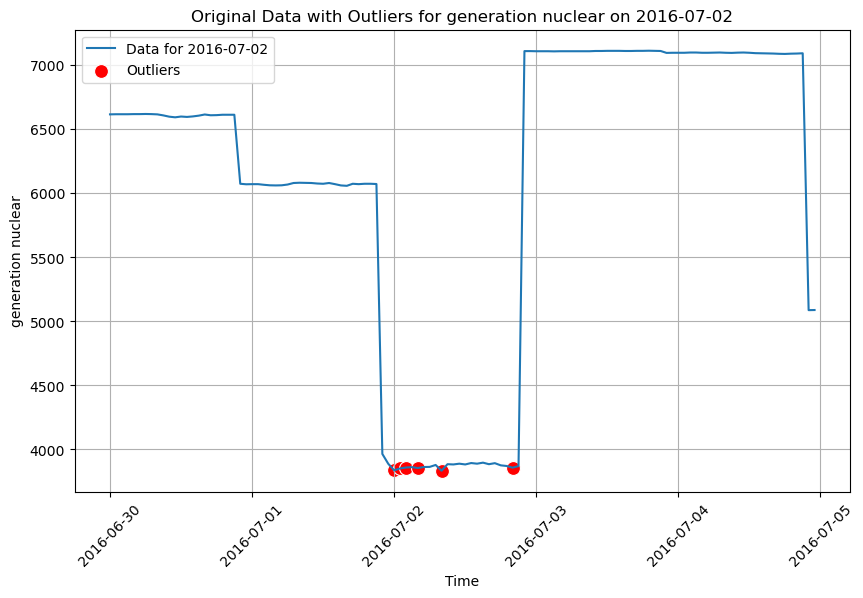

Plotting data for date: 2017-03-06


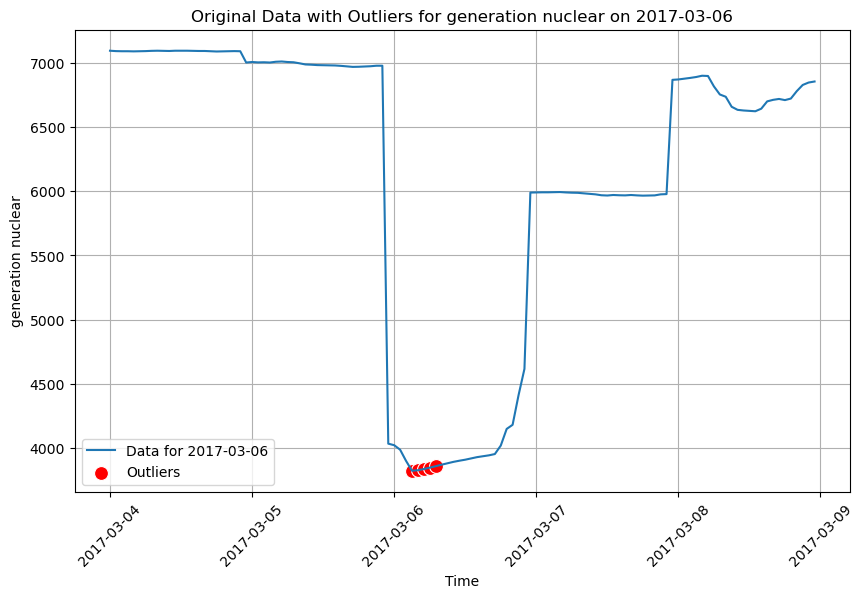

Plotting data for date: 2017-11-12


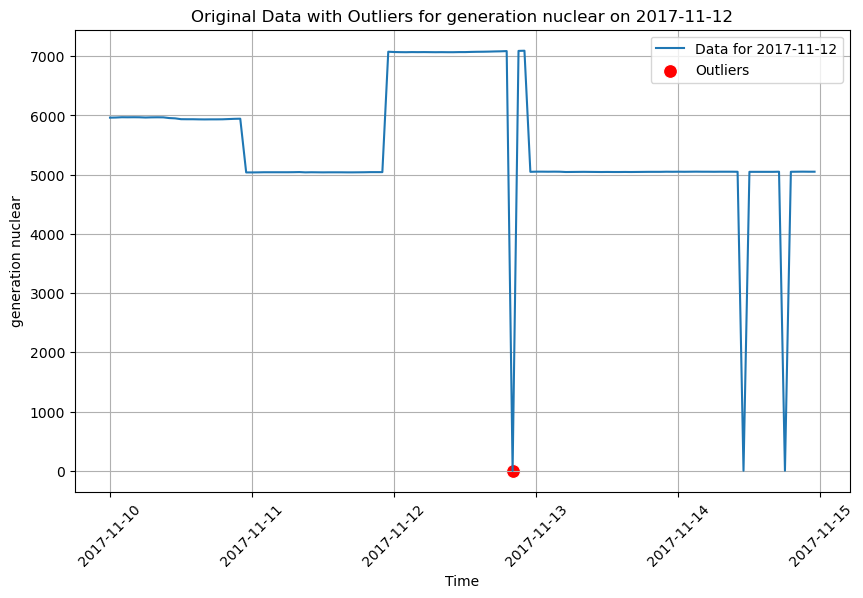

Plotting data for date: 2017-11-14


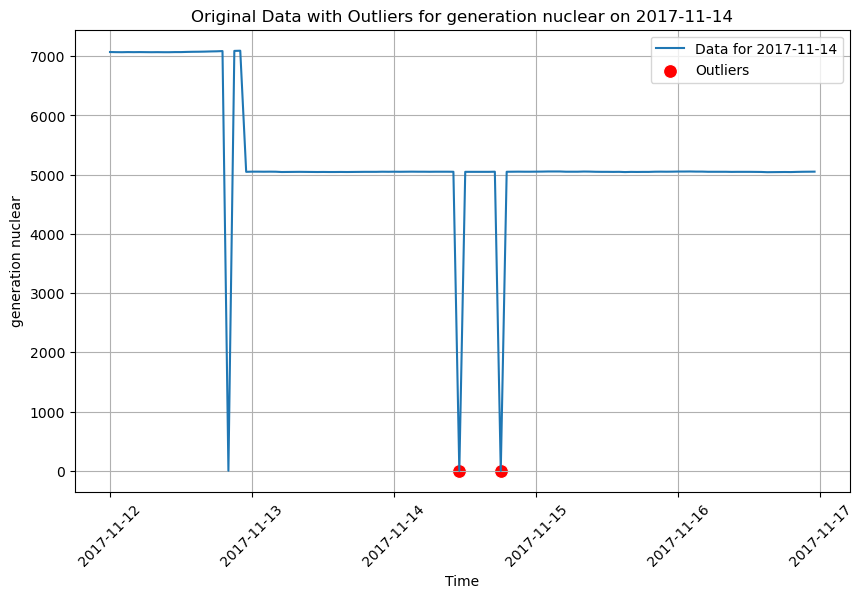

Plotting data for date: 2018-05-06


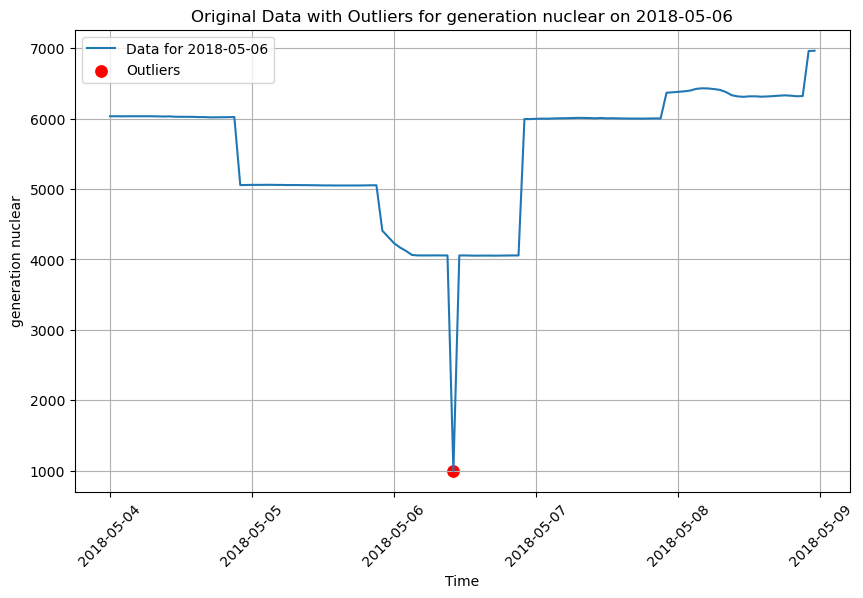

In [26]:
outliers_dates_nuclear = detect_outliers(df=energy_data_, column_name='generation nuclear')

Number of different days with outliers: 25
2015-02-11     5
2015-03-26     1
2015-05-29     3
2015-07-10     1
2015-09-14     1
2015-09-15     7
2015-10-30     1
2015-11-23     1
2015-11-25     1
2015-11-26     5
2016-01-18     6
2016-01-20     6
2016-01-21     4
2016-04-16     6
2016-04-17     2
2016-04-24    11
2016-04-25     1
2016-08-04     2
2017-03-26     1
2017-03-27     8
2017-03-28     4
2017-03-29     6
2017-11-12     1
2017-11-14     2
2018-05-06     1
dtype: int64
Plotting data for date: 2015-02-11


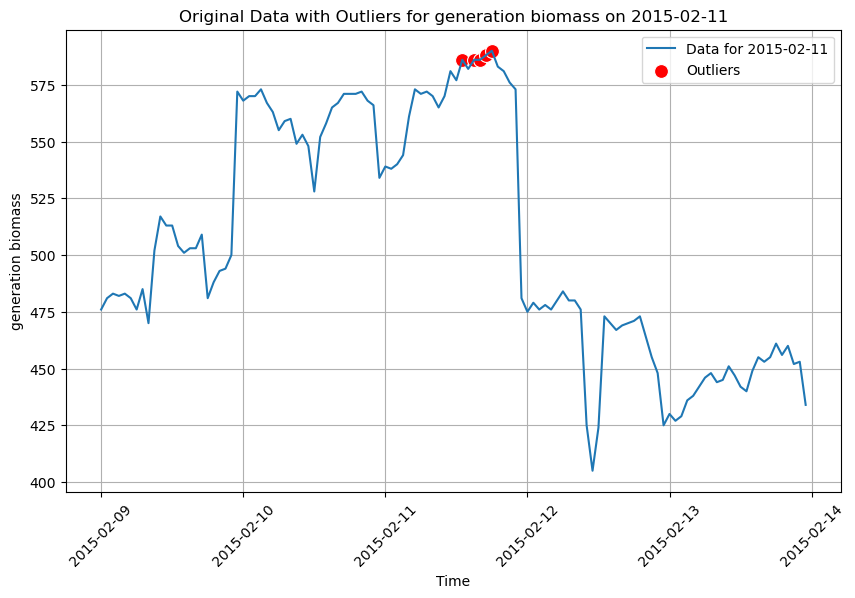

Plotting data for date: 2015-03-26


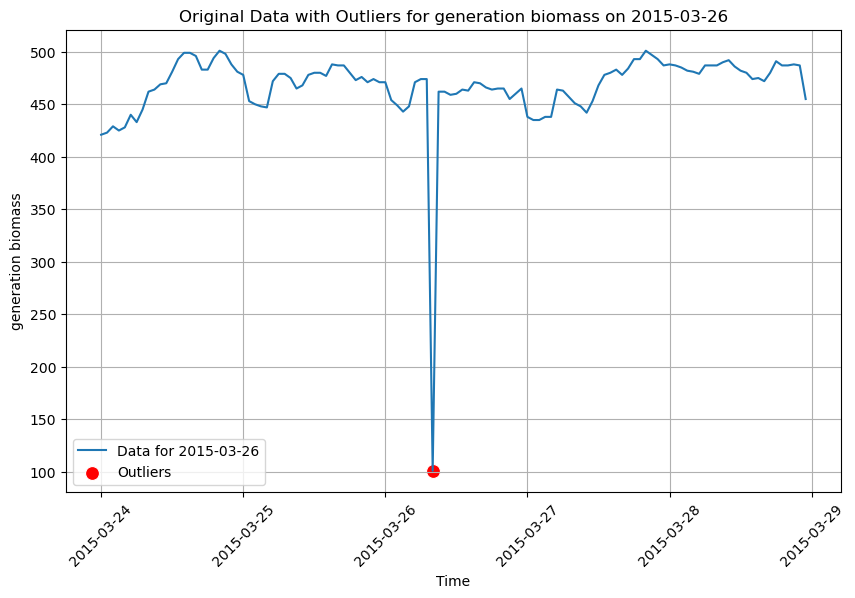

Plotting data for date: 2015-05-29


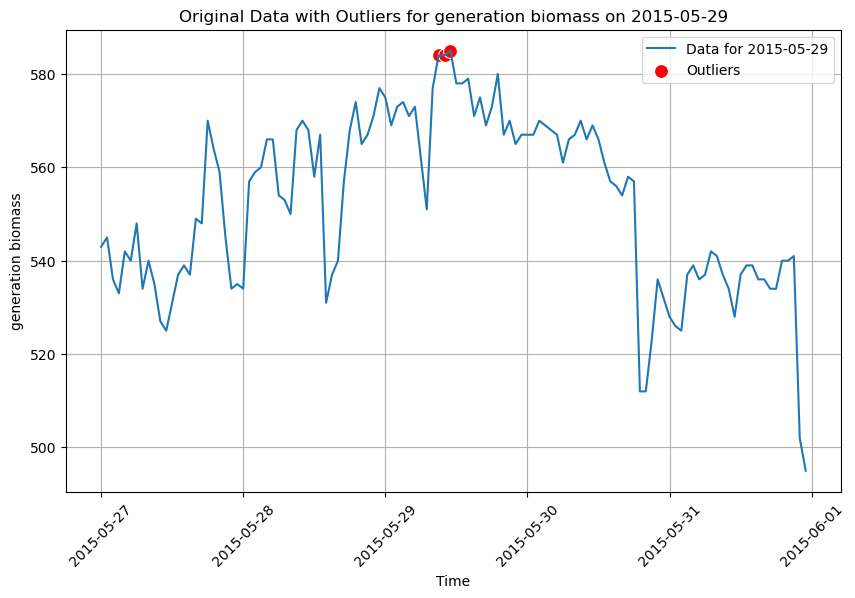

Plotting data for date: 2015-07-10


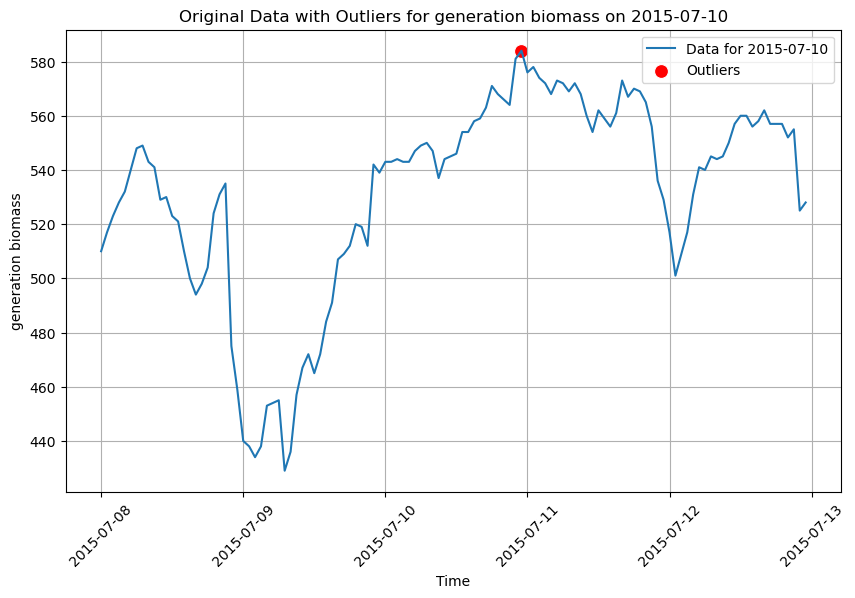

Plotting data for date: 2015-09-14


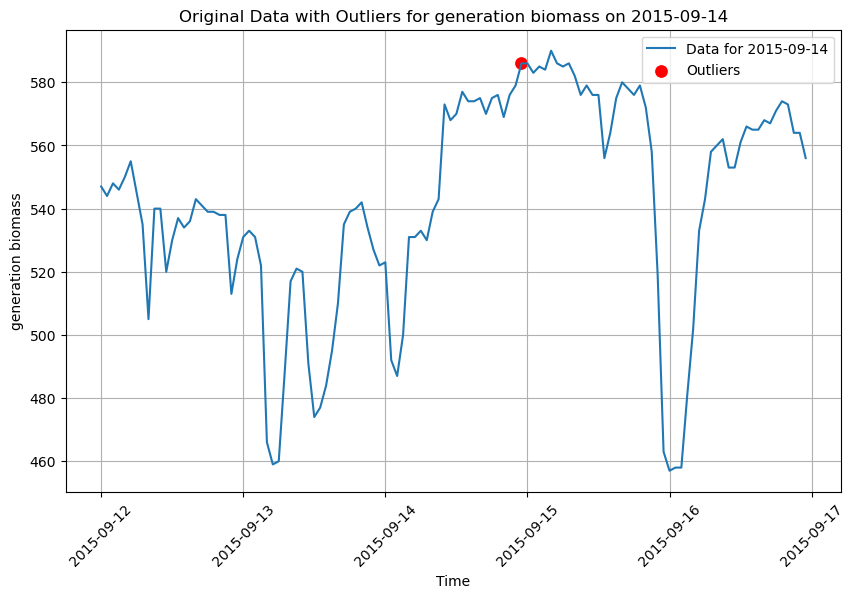

Plotting data for date: 2015-09-15


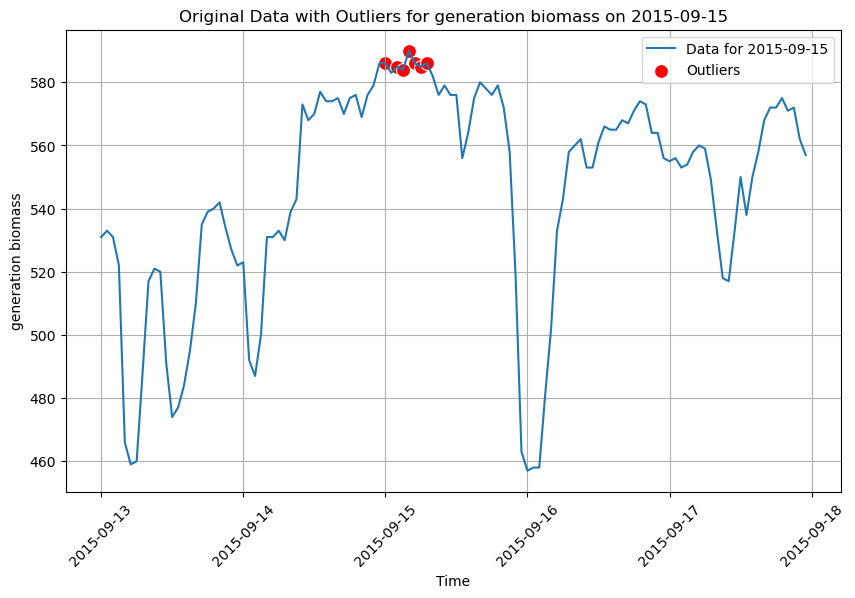

Plotting data for date: 2015-10-30


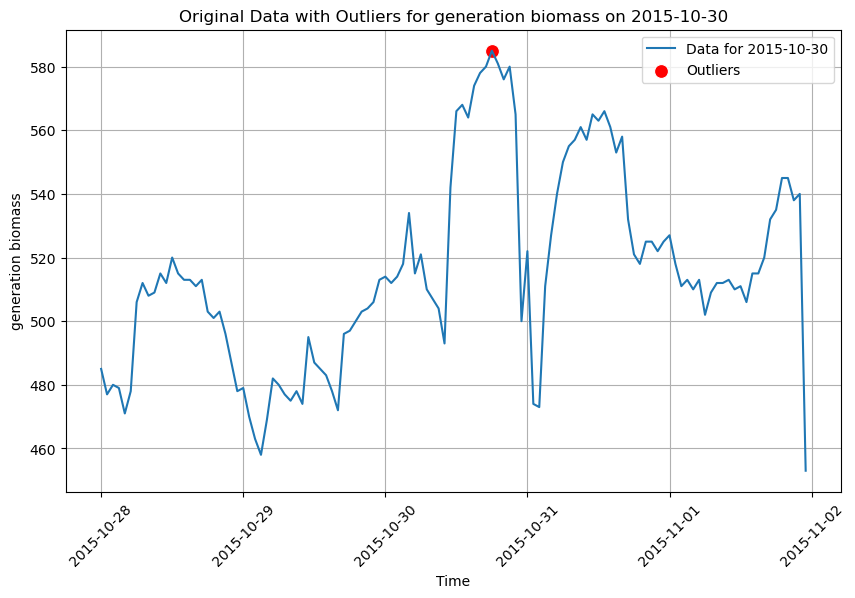

Plotting data for date: 2015-11-23


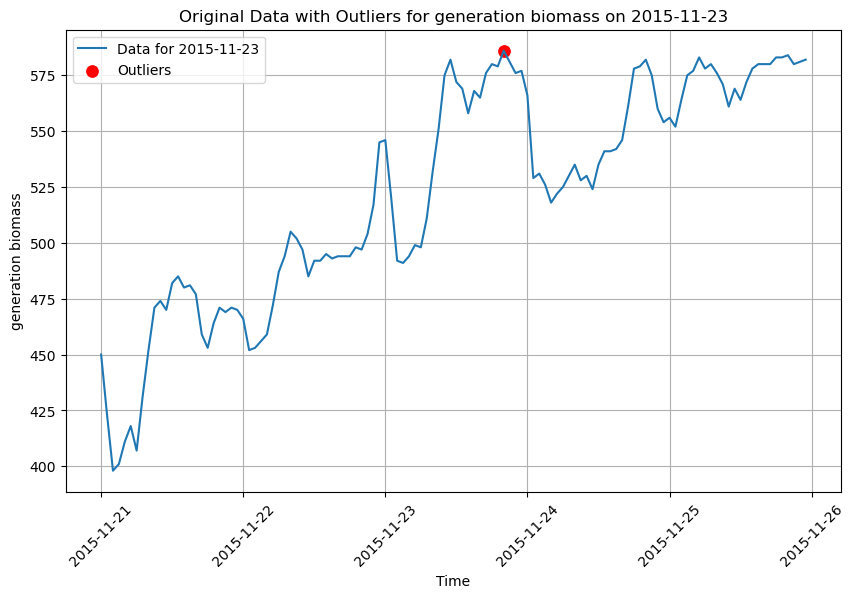

Plotting data for date: 2015-11-25


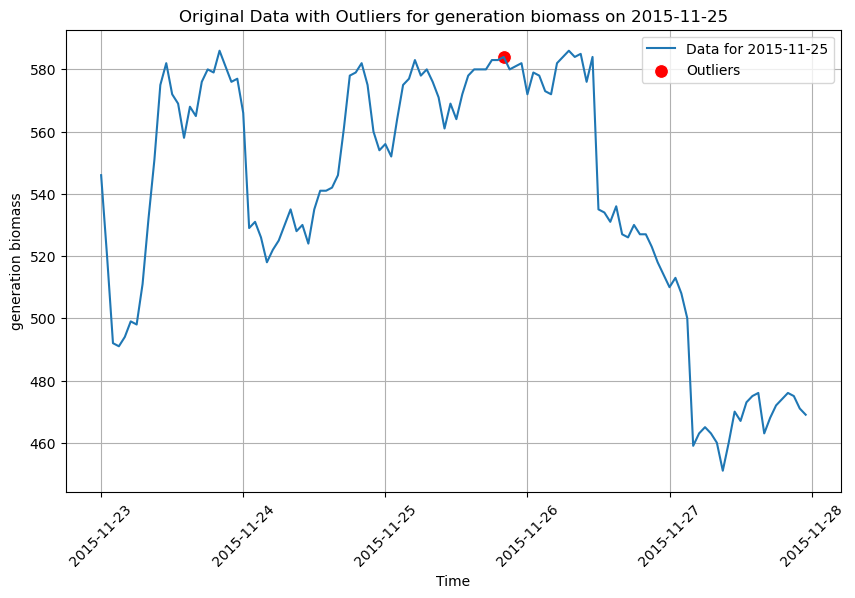

Plotting data for date: 2015-11-26


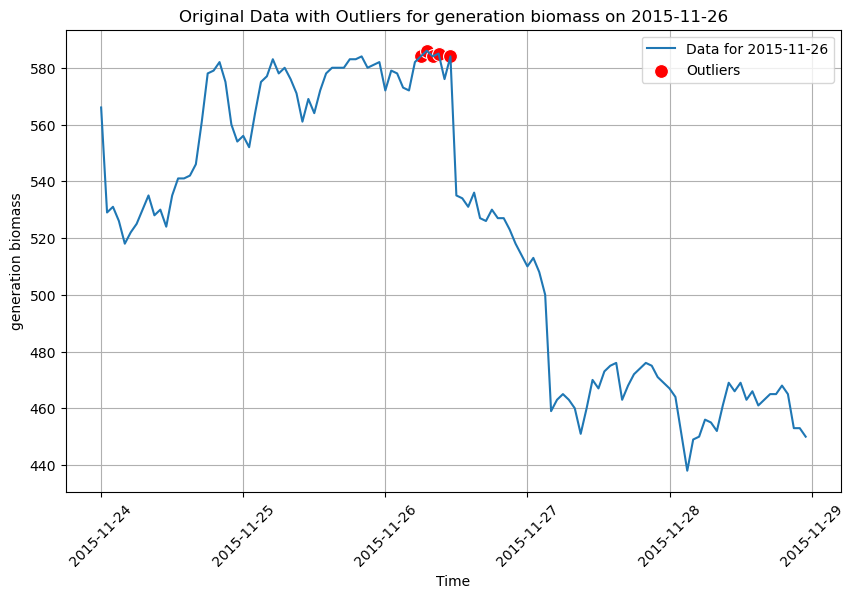

Plotting data for date: 2016-01-18


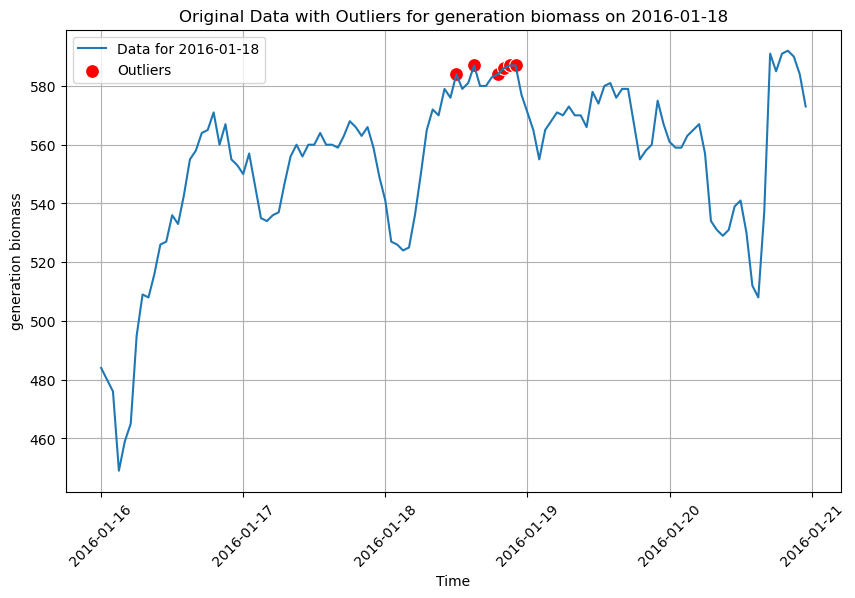

Plotting data for date: 2016-01-20


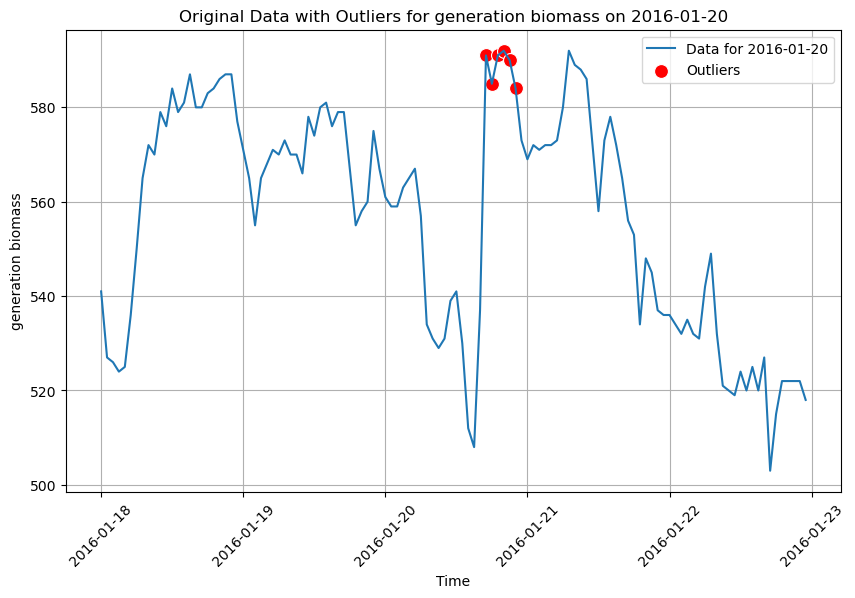

Plotting data for date: 2016-01-21


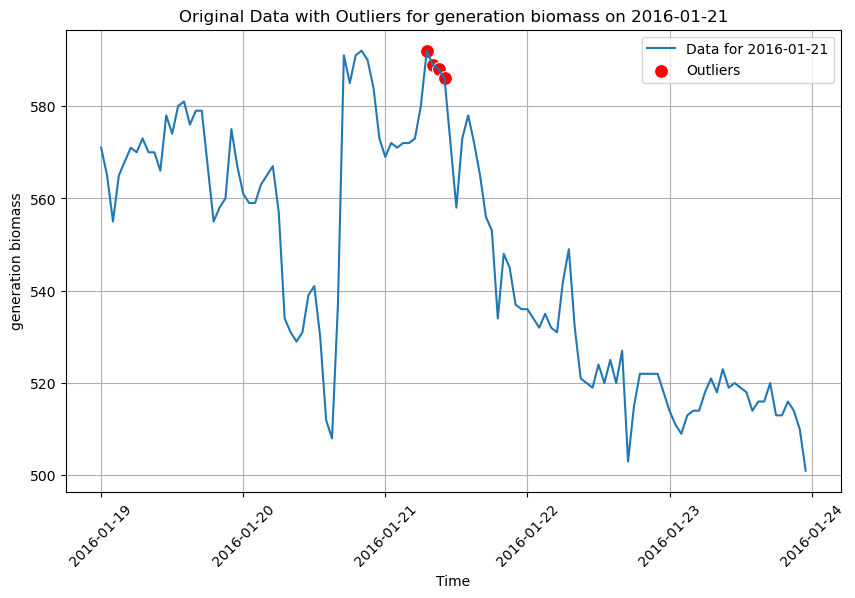

Plotting data for date: 2016-04-16


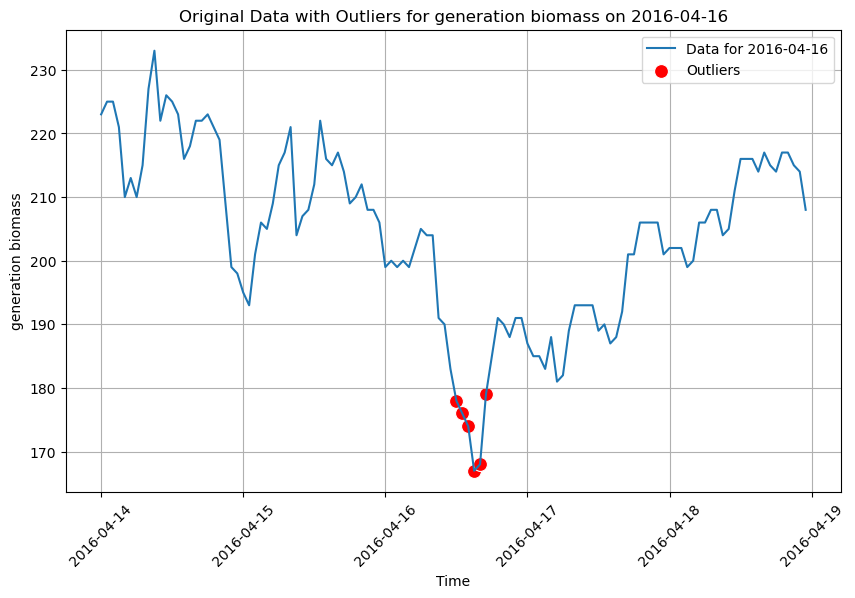

Plotting data for date: 2016-04-17


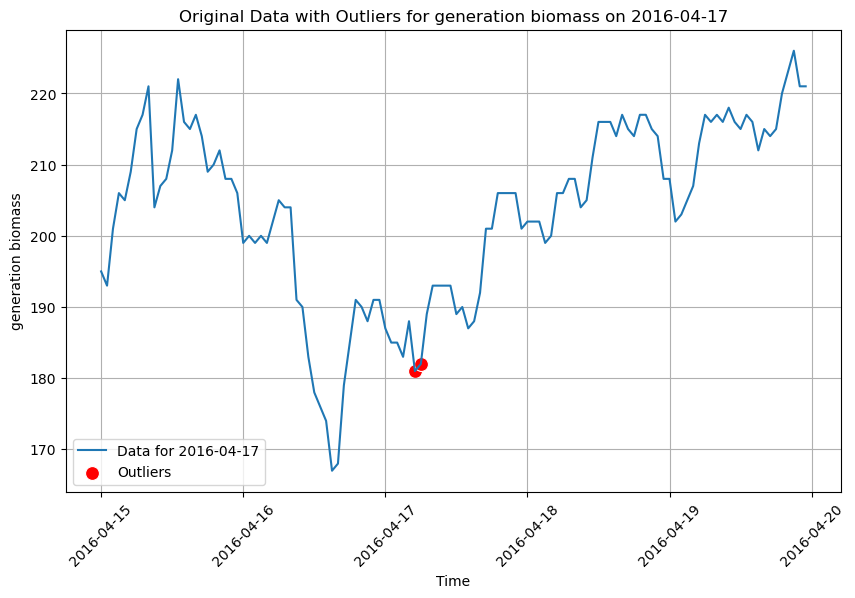

Plotting data for date: 2016-04-24


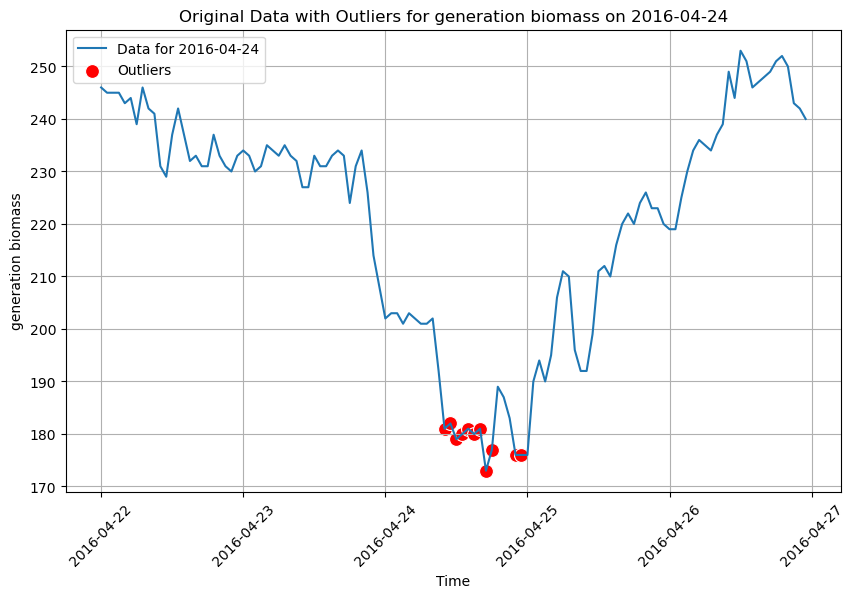

Plotting data for date: 2016-04-25


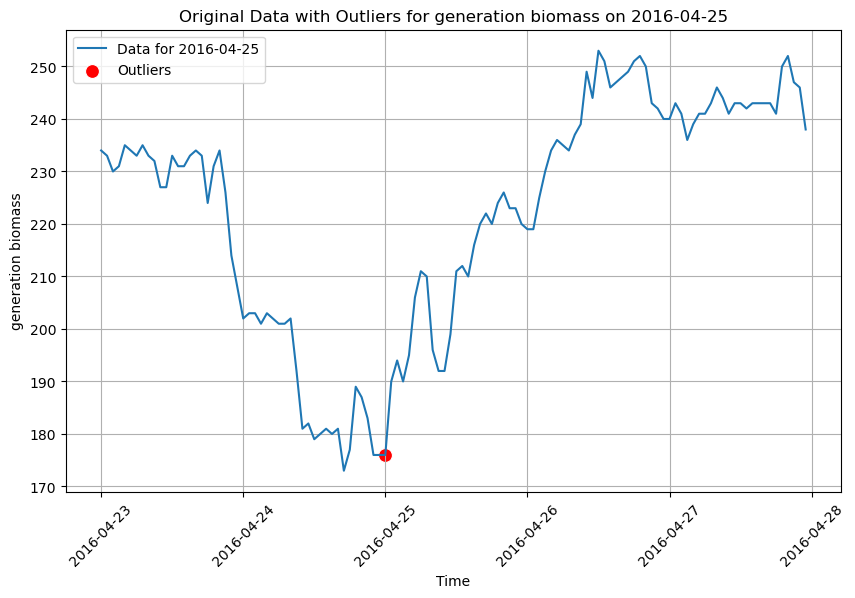

Plotting data for date: 2016-08-04


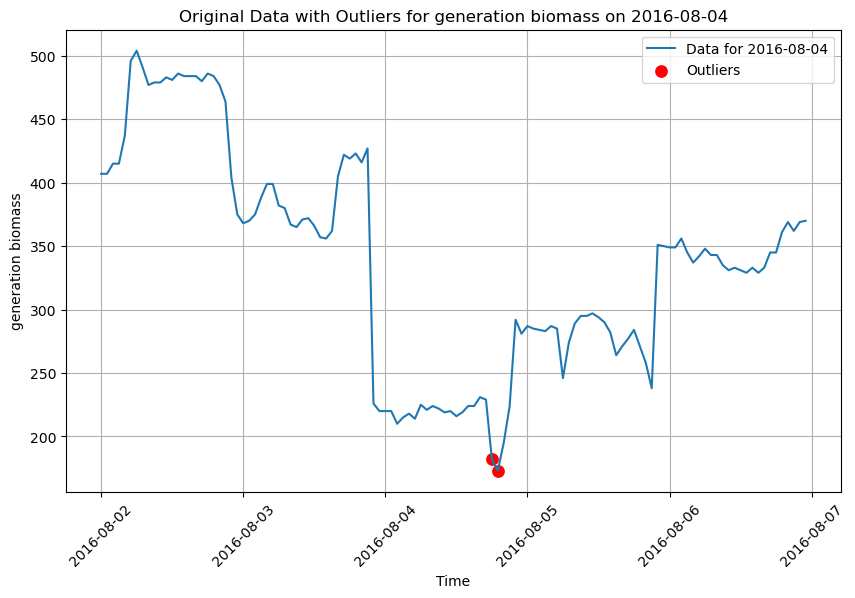

Plotting data for date: 2017-03-26


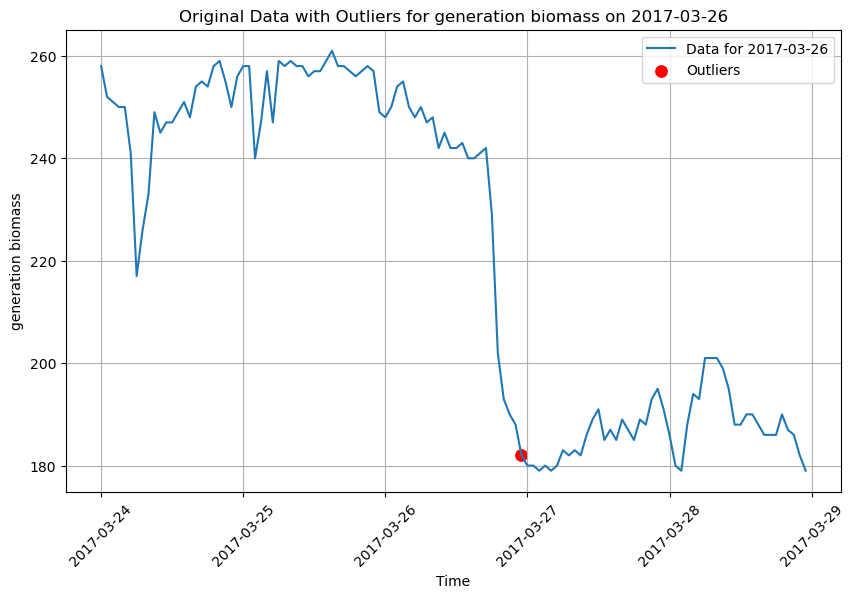

Plotting data for date: 2017-03-27


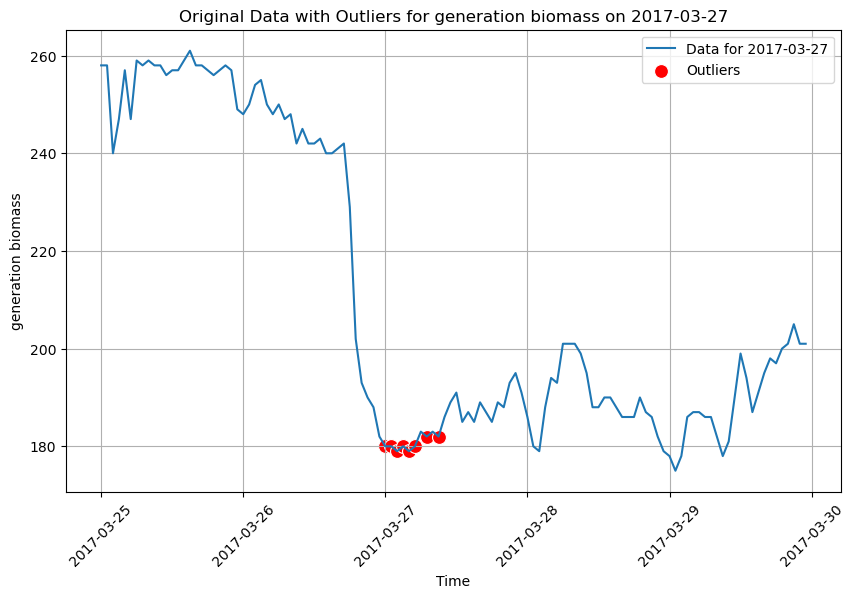

Plotting data for date: 2017-03-28


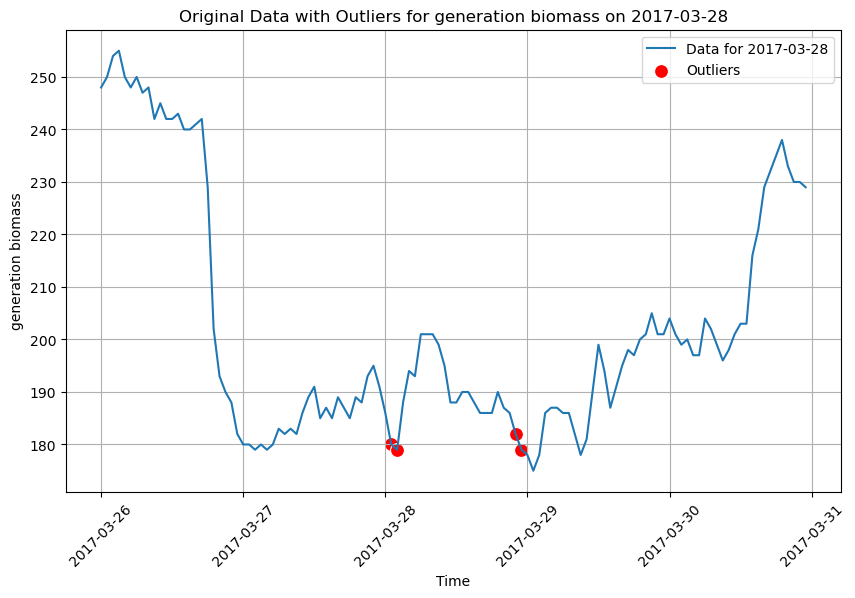

Plotting data for date: 2017-03-29


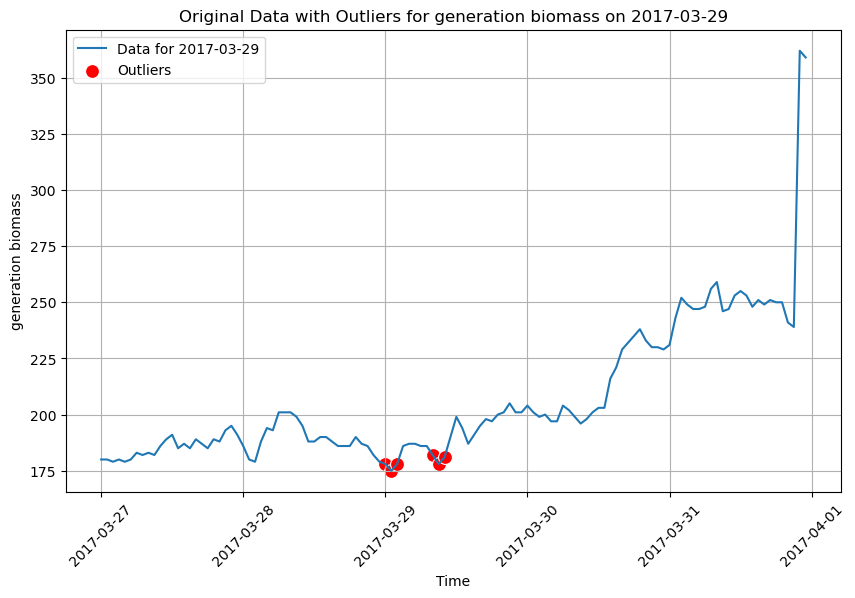

Plotting data for date: 2017-11-12


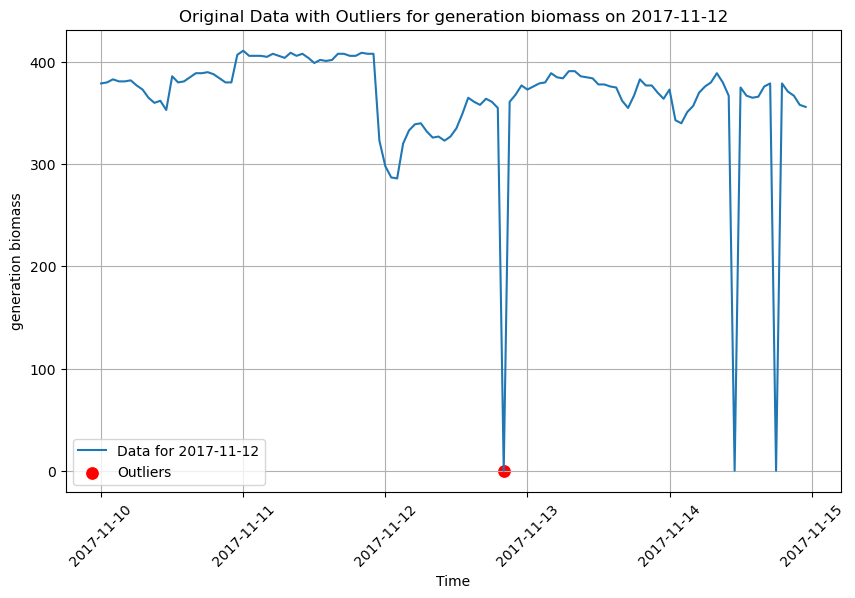

Plotting data for date: 2017-11-14


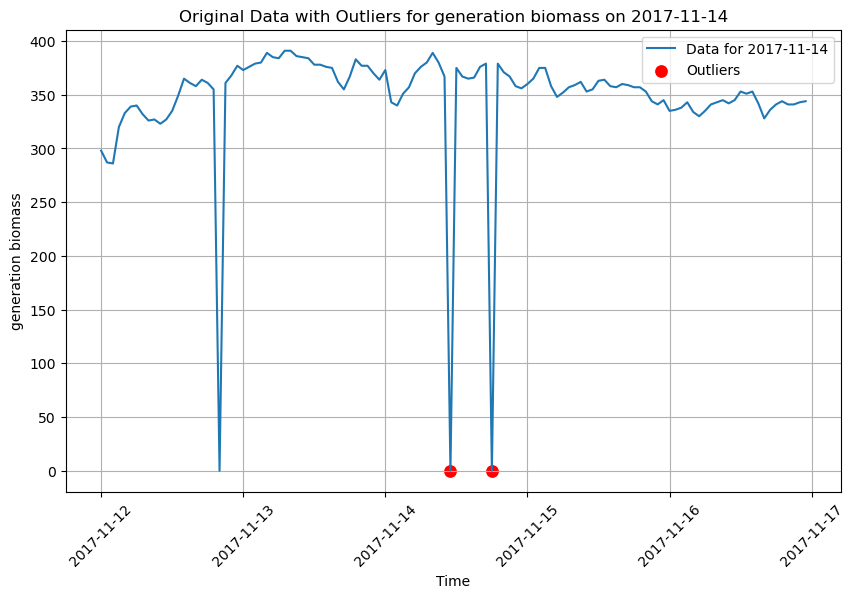

Plotting data for date: 2018-05-06


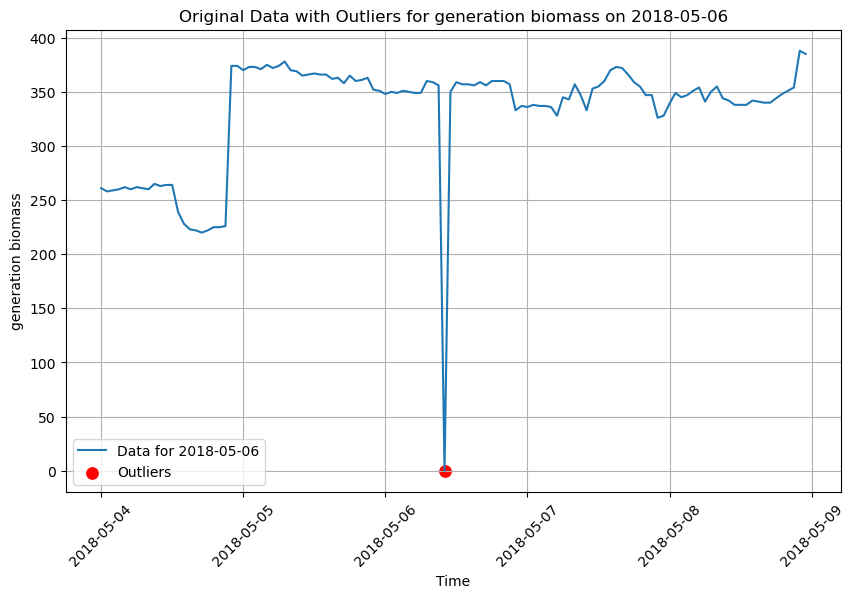

In [27]:
outliers_dates_biomass = detect_outliers(df=energy_data_, column_name='generation biomass')

Number of different days with outliers: 4
2015-03-26    1
2017-11-12    1
2017-11-14    2
2018-05-06    1
dtype: int64
Plotting data for date: 2015-03-26


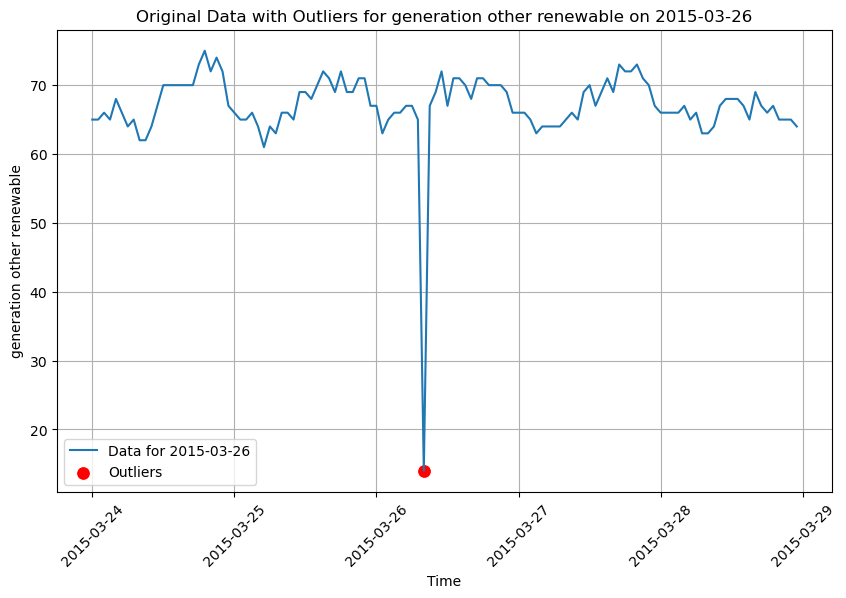

Plotting data for date: 2017-11-12


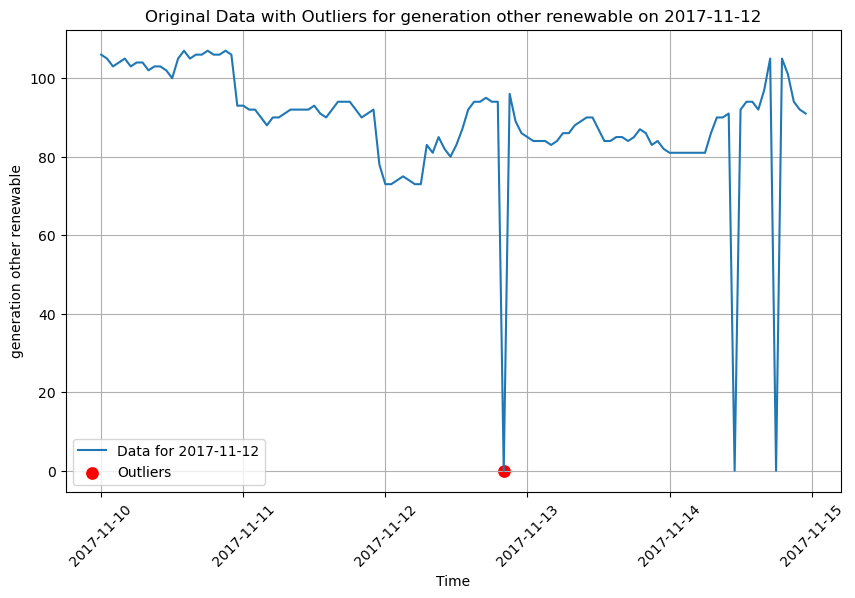

Plotting data for date: 2017-11-14


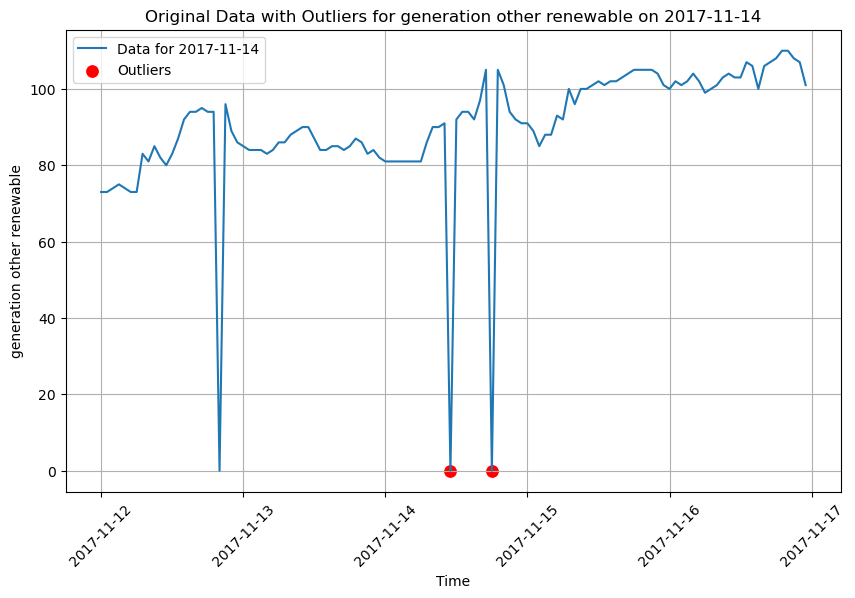

Plotting data for date: 2018-05-06


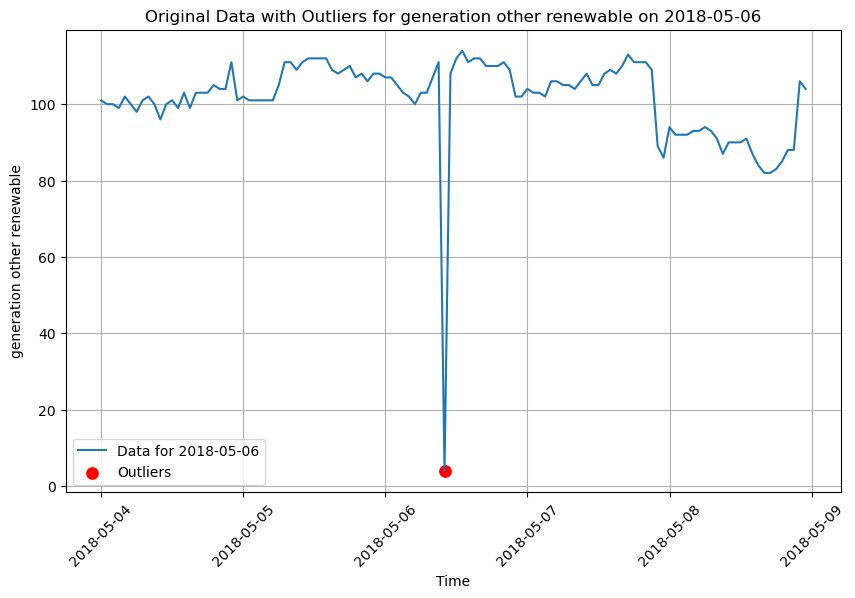

In [28]:
outliers_dates_other_renewable = detect_outliers(df=energy_data_, column_name='generation other renewable')

#### Detect Outliers : Observations#1

Plotting the data reveals some values that appear as outliers but may not be genuine outliers. However, several dates show unusual behavior (I focused more only on 3 columns).

1. Nuclear generation - For nuclear generation there are 3 dates with a stange behaviour:
  - 2017-11-12, 2017-11-14, 2018-05-06: Drops from 5000 MW to 0 MW and returns to 5000 MW.
  - Nuclear plants are typically dispatchable, making these fluctuations implausible.

2. Biomass generation:
  - 2015-03-26: Drops from 400 MW to 100 MW and then returns to 400 MW.
  - 2017-11-12: Drops from 350 MW to 0 MW.
  - 2017-11-14: Same drop as above.
  - 2018-05-06: Similar drop as above.

3. Other renewables:
  - Same affected dates as biomass: 2015-03-26, 2017-11-12, 2017-11-14, and 2018-05-06.

**Conclusion**
The data points occur on the same dates across different generation sources, indicating a possible systemic issue rather than random errors. It's highly unlikely for nuclear energy generation to drop to 0 MW.

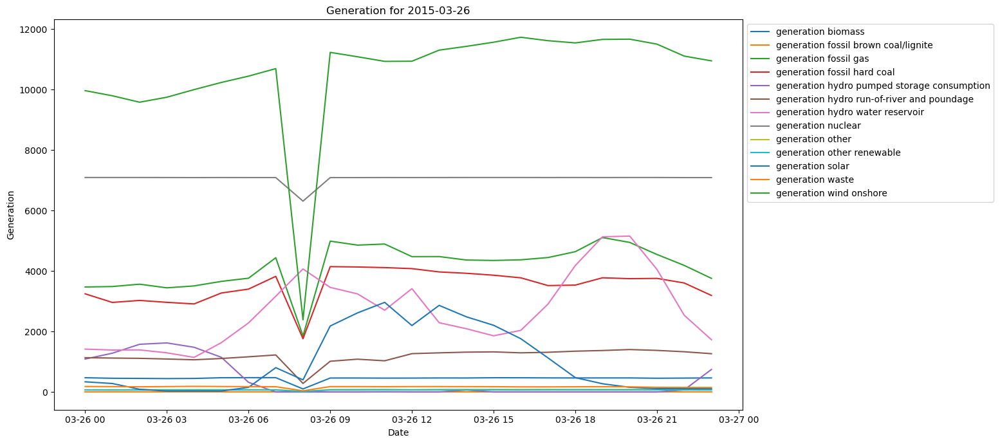

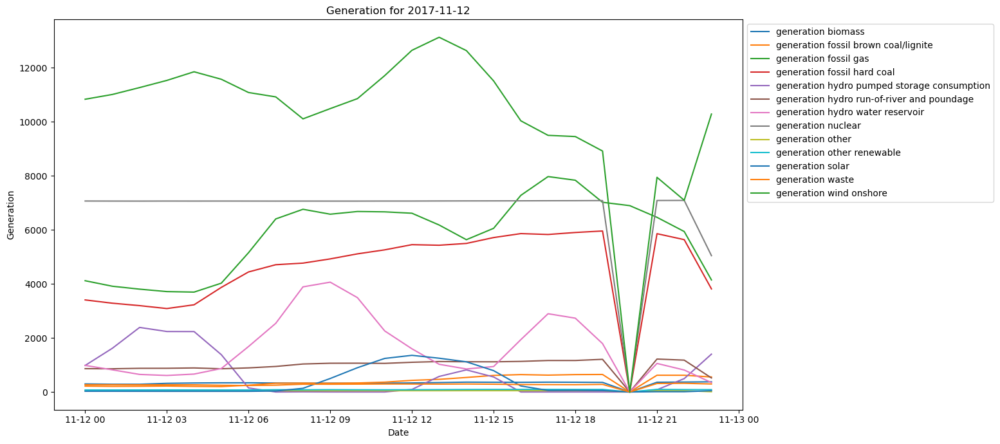

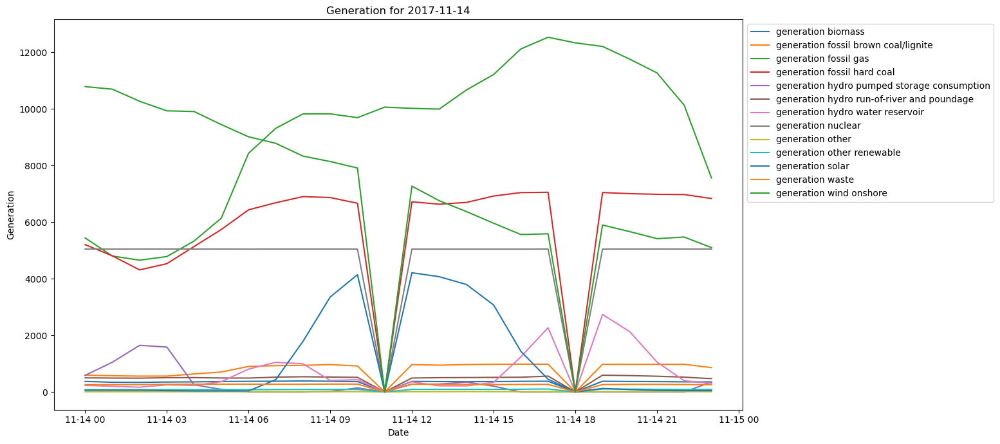

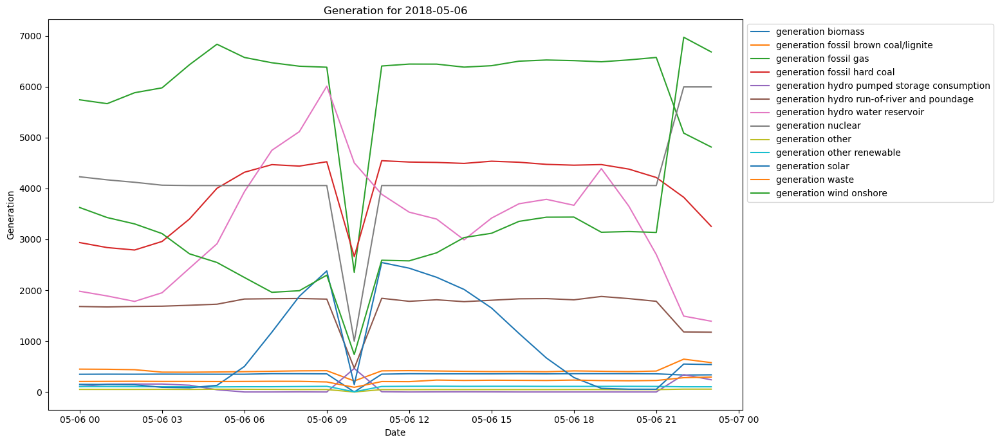

In [29]:
# Plot dates
dates = ['2015-03-26', '2017-11-12', '2017-11-14', '2018-05-06']
generation_columns = energy_data_.loc[:, energy_data_.columns.str.contains('generation')]
for date in dates:
  fig, ax = plt.subplots(figsize=(12,7))
  ax.plot(generation_columns[generation_columns.index.date == np.datetime64(date)], label=generation_columns.columns)
  ax.set_title(f'Generation for {date}')
  ax.set_xlabel('Date')
  ax.set_ylabel('Generation')
  plt.tight_layout()
  plt.legend(bbox_to_anchor=(1, 1))
  plt.show()

#### Detect Outliers : Observations#2

I will modify the outlier values for 2017-11-12 and 2017-11-14. On these dates, all energy generation drops to 0 MW, which is particularly concerning, especially since nuclear generation also reaches 0 MW. This indicates that these values should be substituted.

I will not change the data for 2015-03-26 and 2018-05-06 because the values do not drop to zero. Instead, there is a decrease in generation while hydro pumped storage consumption increases. This behavior may be due to grid management practices.
  

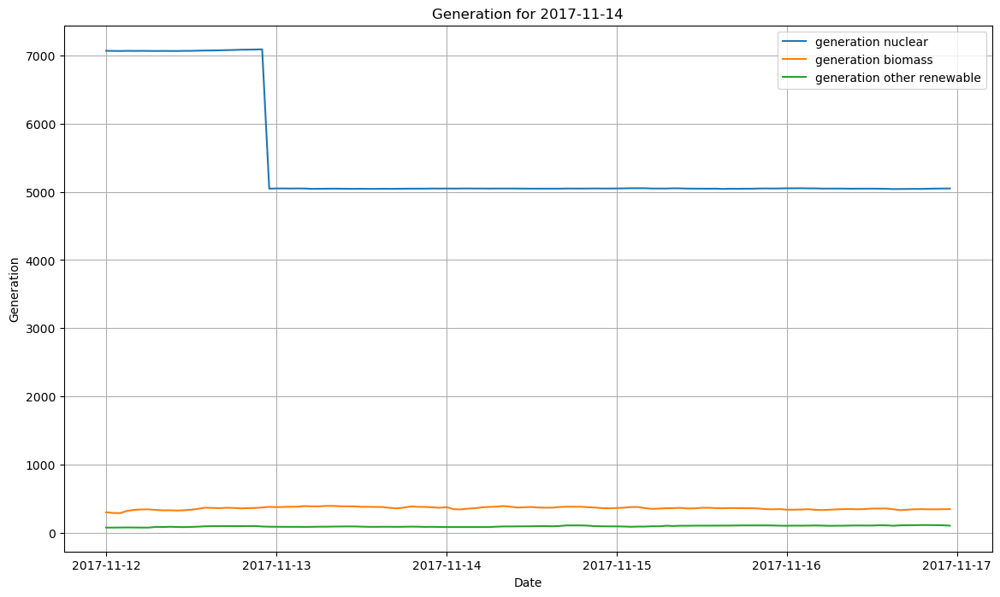

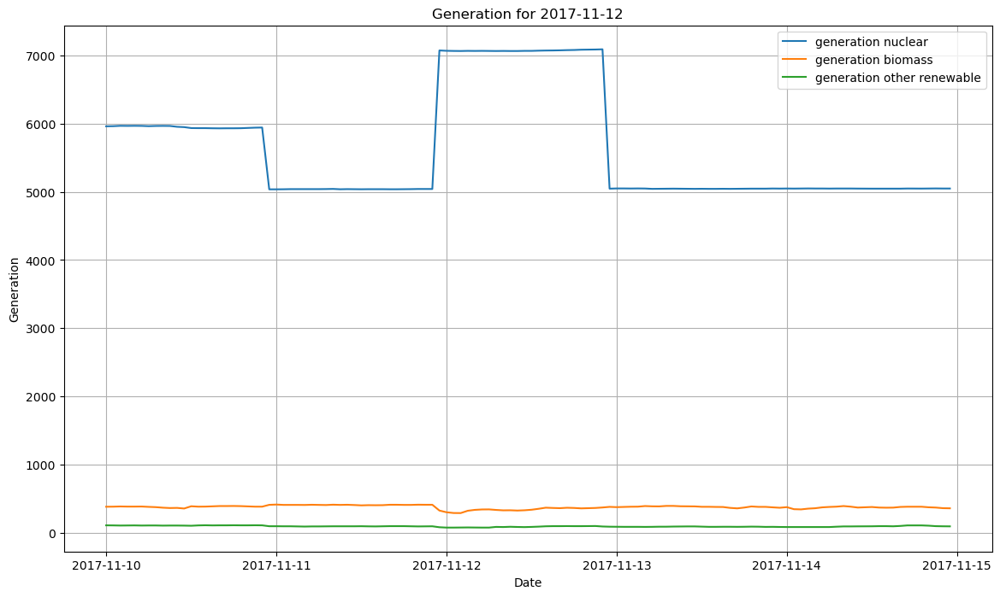

In [30]:
columns = ['generation nuclear', 'generation biomass', 'generation other renewable']
energy_data_[columns] = apply_linear_interpolation_nan_values(energy_data_, columns=columns,
                                         date='2017-11-12', hour=20)
energy_data_[columns]= apply_linear_interpolation_nan_values(energy_data_, columns=columns,
                                        date='2017-11-14', hour=11)
energy_data_[columns] = apply_linear_interpolation_nan_values(energy_data_, columns=columns,
                                         date='2017-11-14', hour=18)

plot_day(energy_data_[columns],'2017-11-14')
plot_day(energy_data_[columns],'2017-11-12')

In [31]:
energy_data_.isnull().sum().sum()

0

### 5. Visual Exploration

Types of visuals examples:
1. Univariate Analysis:
  - Continuous Variables:
      **Measures**: Central tendency (mean, median, mode), dispersion (range, quantiles, IQR, variance, standard deviation), skewness, and kurtosis.
      **Visualizations**: Box plots, histograms.

  - Categorical Variables:
      **Measures**: Frequency and distribution of values.
      **Visualizations**: Bar plots, pie charts.


2. Bivariate Analysis:
      
  **Continuous vs Continuous**: correlation, scatter plots, heatmaps
      
  **Categorical vs Categorical**: Chi-Square Test (used to determine if two categorical variables are related)


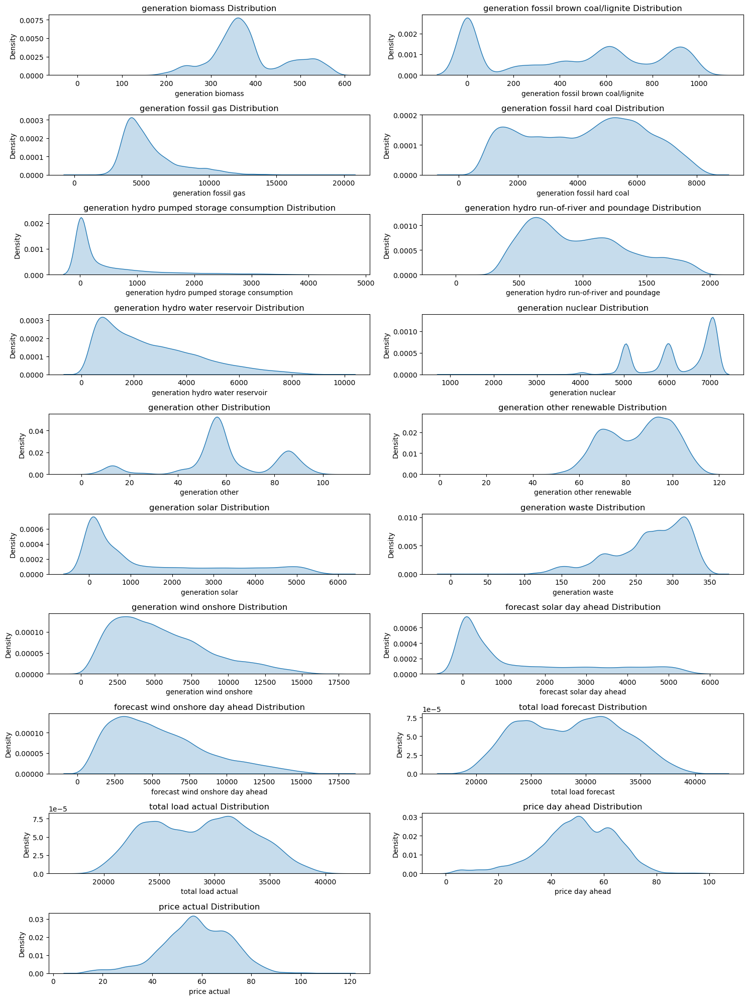

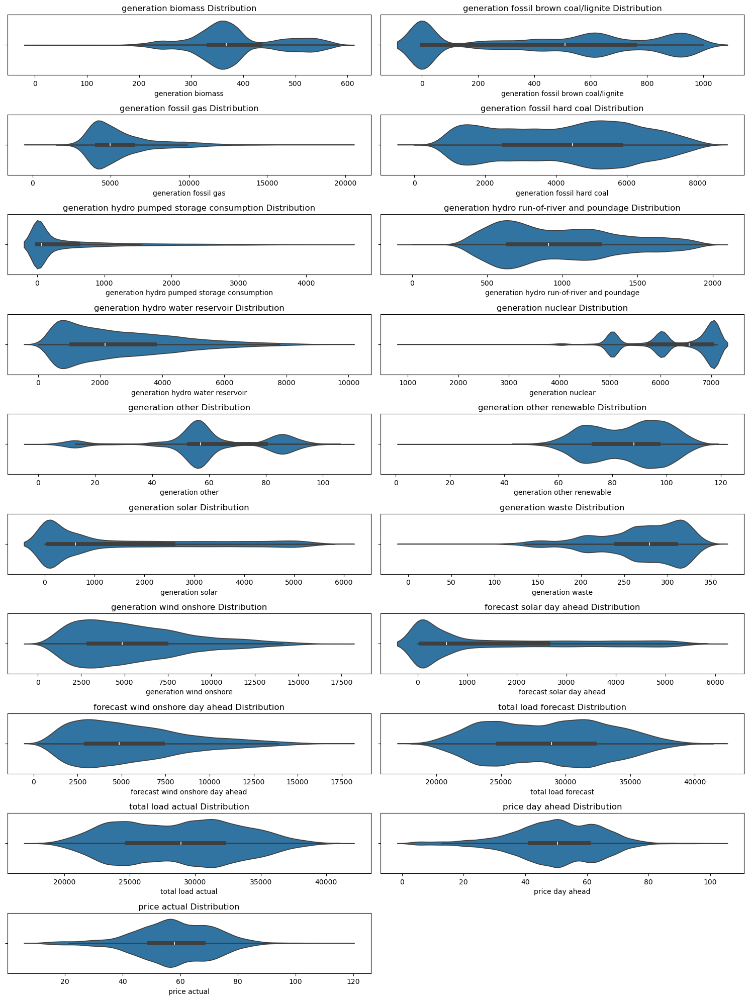

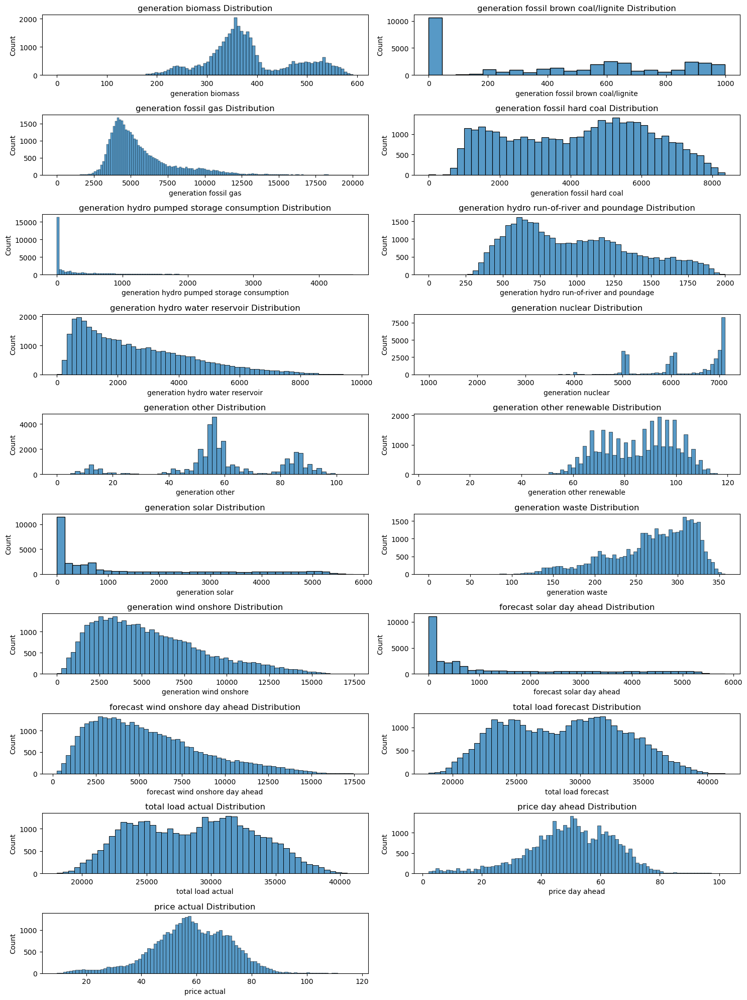

In [32]:
data_visualizations_plots(energy_data_, 'kdeplot')
data_visualizations_plots(energy_data_, 'violin')
data_visualizations_plots(energy_data_, 'histoplot')

In [33]:
# Rank generation types by total generation
sum_values = generation_columns.sum()
sum_values.sort_values(ascending=False)

generation nuclear                             2.196228e+08
generation fossil gas                          1.971554e+08
generation wind onshore                        1.916241e+08
generation fossil hard coal                    1.492510e+08
generation hydro water reservoir               9.136378e+07
generation solar                               5.024504e+07
generation hydro run-of-river and poundage     3.408929e+07
generation hydro pumped storage consumption    1.667729e+07
generation fossil brown coal/lignite           1.571199e+07
generation biomass                             1.344814e+07
generation waste                               9.446897e+06
generation other renewable                     3.002682e+06
generation other                               2.111766e+06
dtype: float64

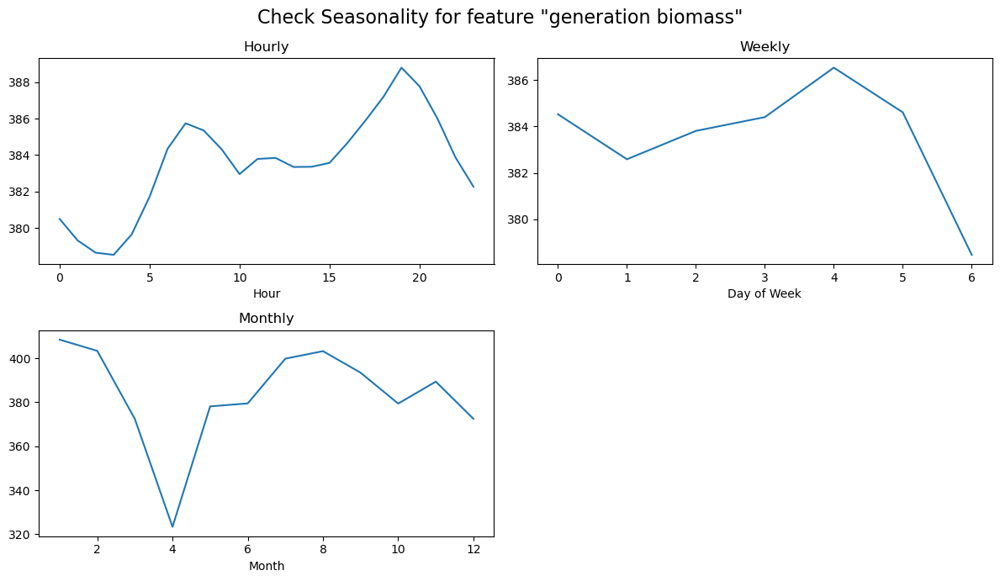

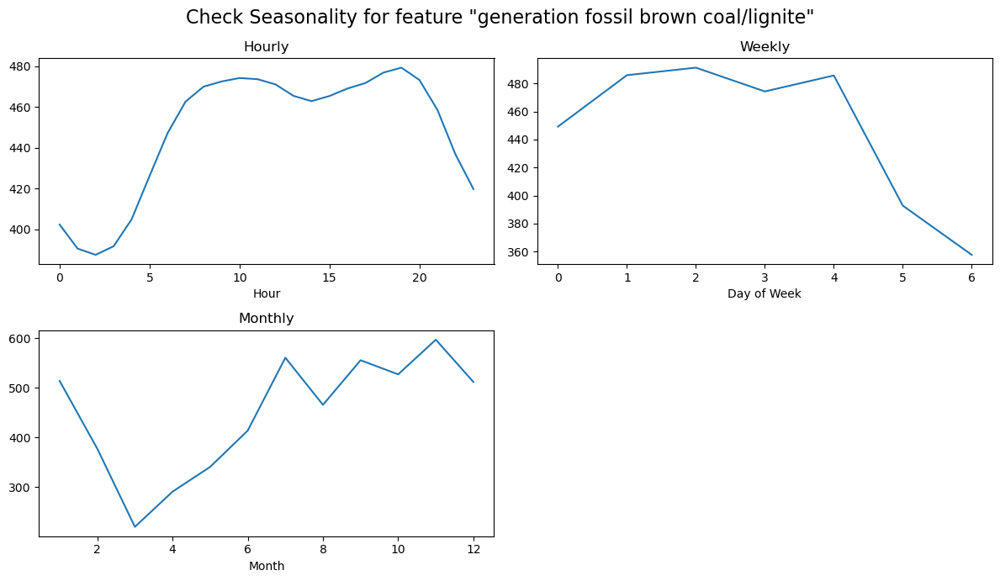

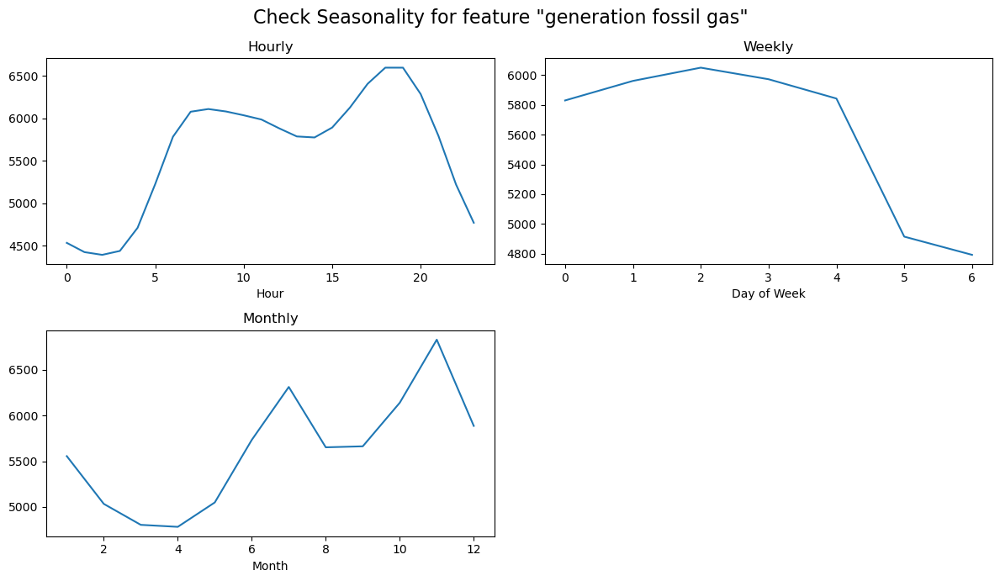

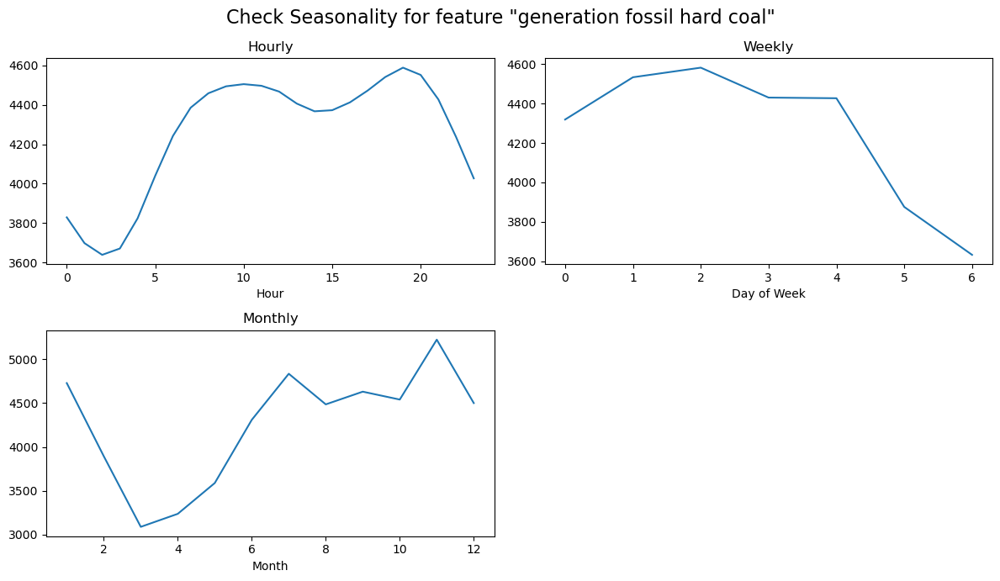

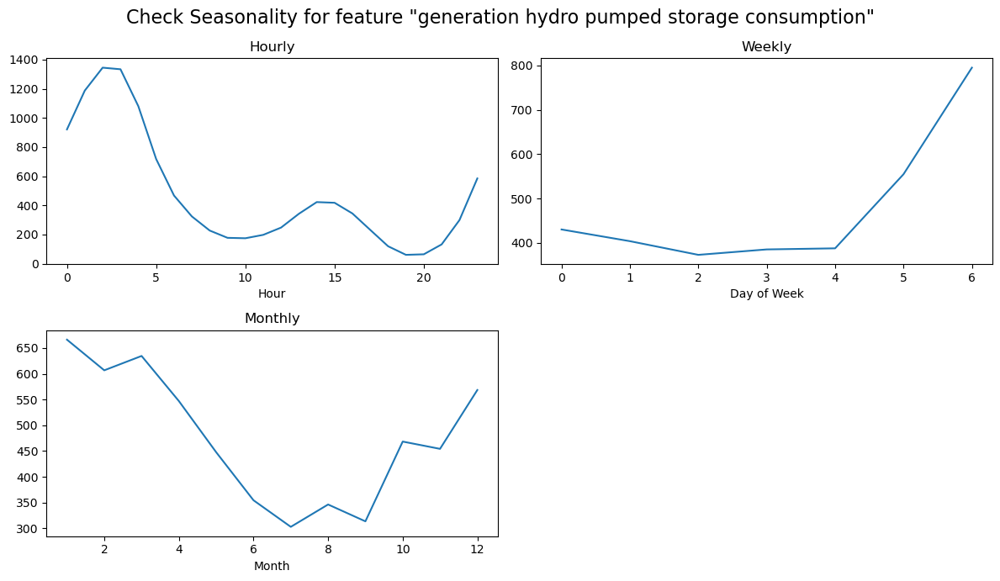

...

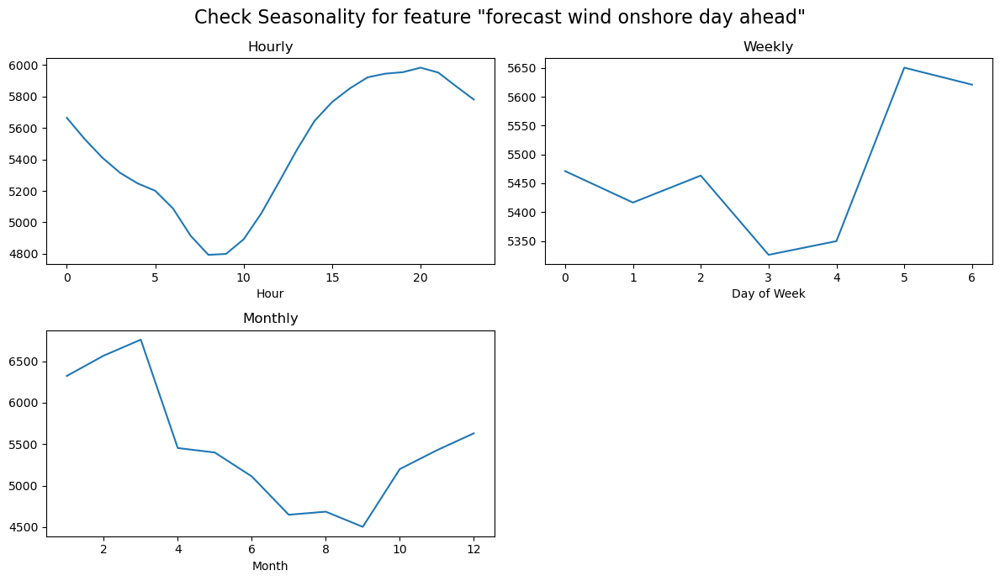

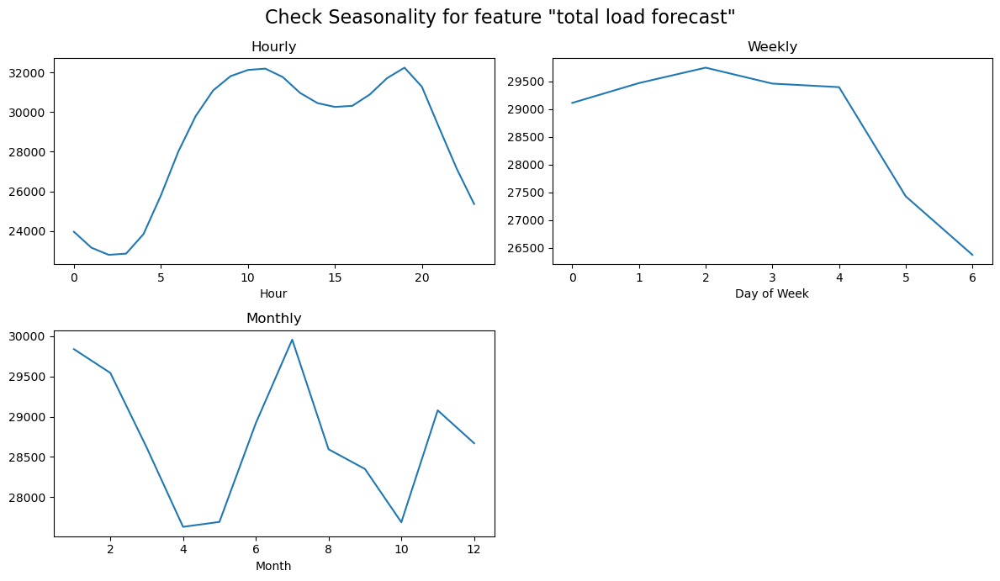

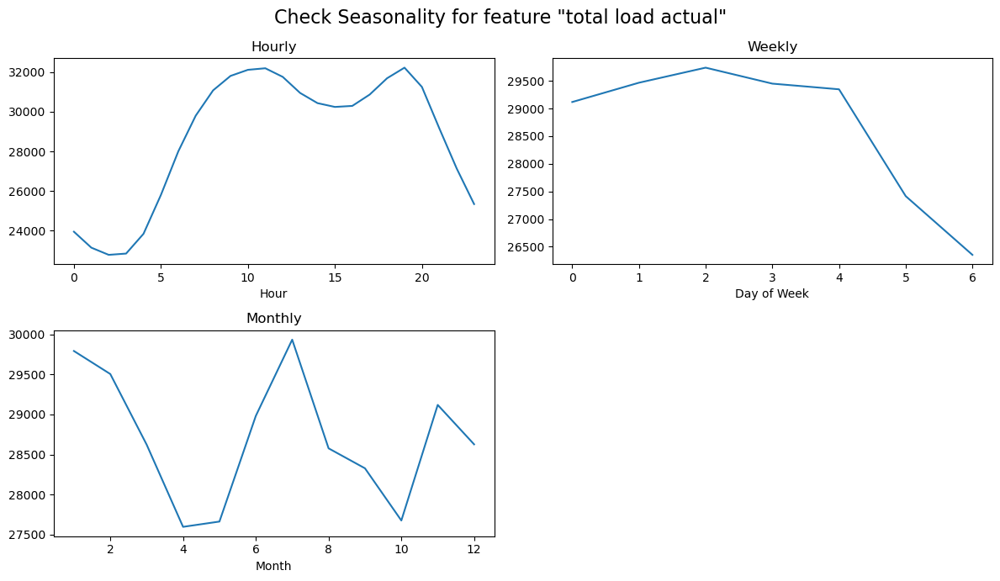

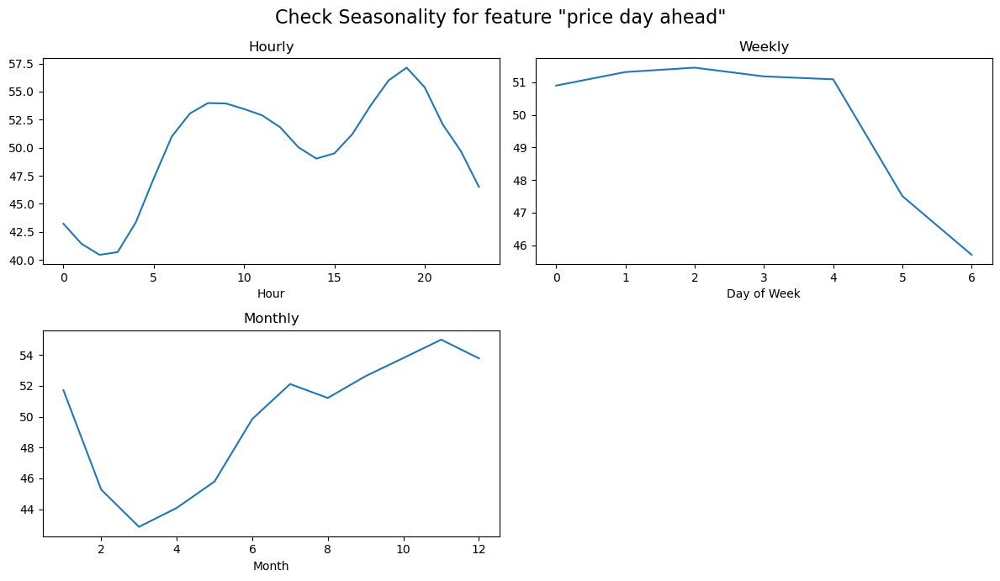

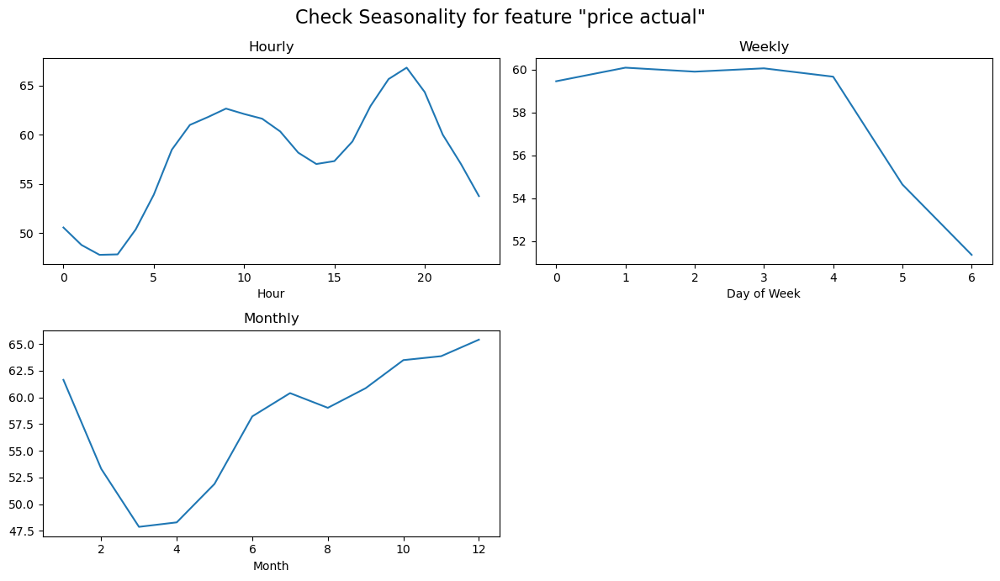

In [34]:
for column in energy_data_.columns:
   see_seasonality(energy_data_, column)

#### 5. Visual Exploration: Observations#1

From the plots above, we observe that different columns/features have varying distributions, and there is a significant difference in the values generated by different energy sources. These generation types operate on different scales.

General Insights:
  - The most efficient power plants, such as nuclear, which have the lowest operating costs, run consistently for most of the time.
  - For instance, some electricity generation types, like hydro storage, are primarily used for balancing supply and demand, resulting in distributions with many zero values. This is also observed in solar generation due to intermittent availability (e.g., no production at night).

Top 5 generation types:
  1. Nuclear: steady (25th percentile = 6566.00; 75h percentile =7025.00 and max=7117.00)

  2. Fossil gas: Higher consumption in the last months of the year and during late hours of the day. Generates more during weekdays.

  3. Wind onshore: Higher generation during the early months of the year.

  4. Fossil hard coal: Generally increases during periods of higher demand.

**Conclusions**
  - Most of the top generation types produce more electricity on weekdays, likely due to higher industrial and commercial demand.
  - The target variable (price) appears to follow a Gaussian distribution and tends to be more expensive during weekdays and last hours of the day

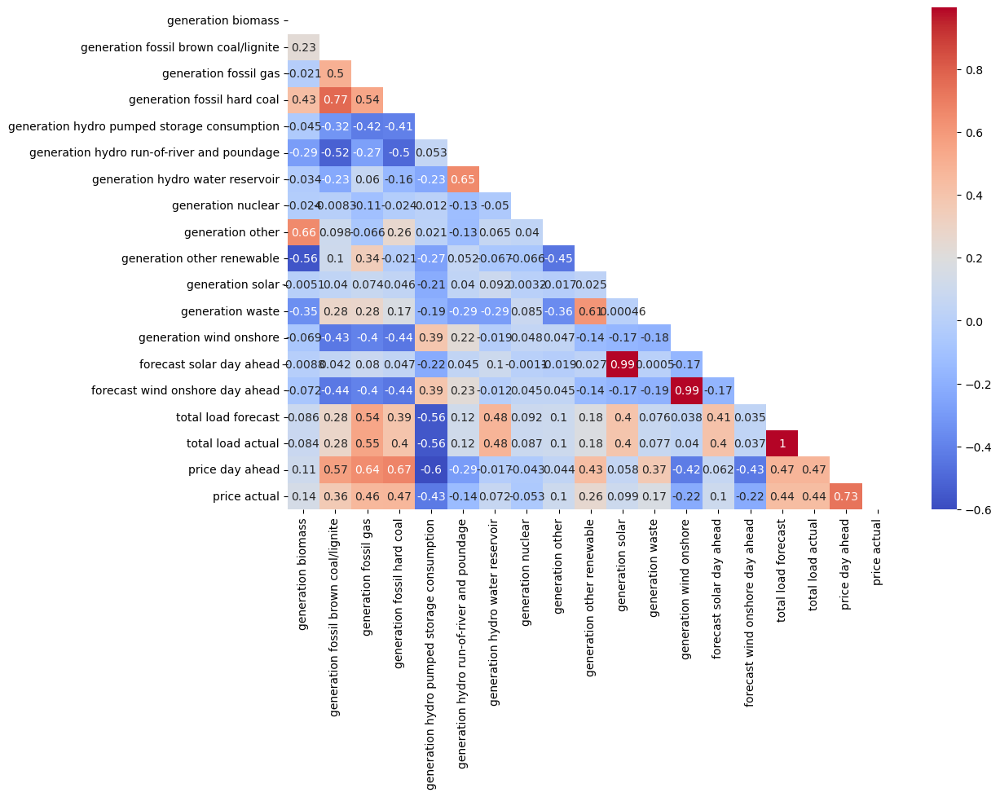

price actual                                   1.000000
price day ahead                                0.732155
generation fossil hard coal                    0.465637
generation fossil gas                          0.461471
total load forecast                            0.435864
total load actual                              0.435478
generation fossil brown coal/lignite           0.363993
generation other renewable                     0.256452
generation waste                               0.168710
generation biomass                             0.143106
forecast solar day ahead                       0.101402
generation other                               0.099914
generation solar                               0.098609
generation hydro water reservoir               0.071967
generation nuclear                            -0.052660
generation hydro run-of-river and poundage    -0.136659
generation wind onshore                       -0.220497
forecast wind onshore day ahead               -0

In [37]:
plot_correlation(energy_data_, 'pearson')

#### 5. Visual Exploration: Observations#2

**Correlation with Target Variable**
  - There is a strong correlation between the target variable and the 'price day ahead' feature.
  - A medium correlation exists with fossil generation sources.
  - Hydro pumped storage shows a medium negative correlation with the target variable. This may be due to its operational characteristics: it typically stores energy when prices are low and generates electricity during peak demand periods when prices are high. As a result, it helps balance the market by reducing the need for additional generation during high-demand times.

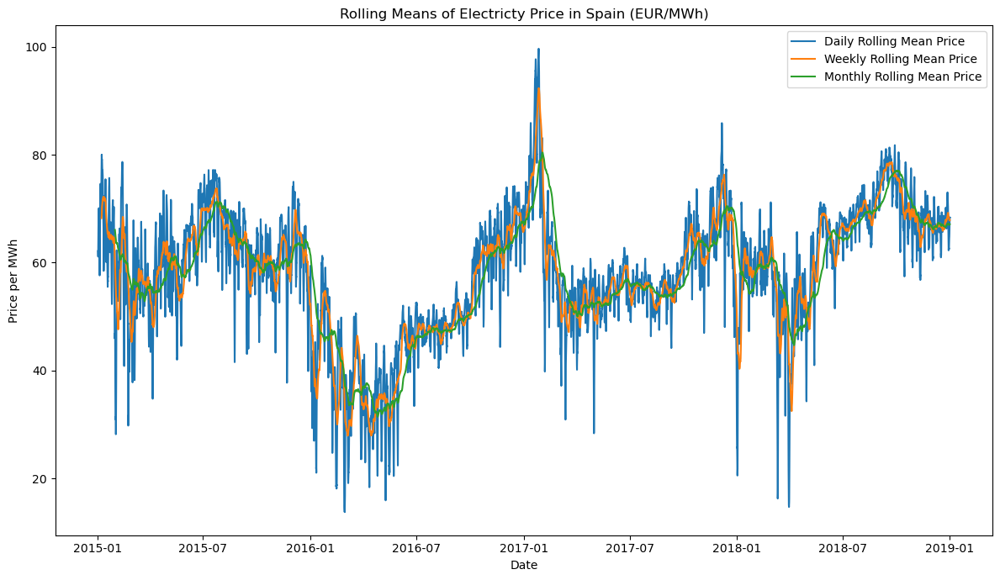

In [38]:
# Visualize target value
# plot weekly, monthly and daily rolling mean - 'price actual' columns
fig, ax = plt.subplots(figsize=(12,7))
plt.plot(energy_data_['price actual'].rolling(window=1*24).mean(), label='Daily Rolling Mean Price')
plt.plot(energy_data_['price actual'].rolling(window=7*24).mean(), label='Weekly Rolling Mean Price')
plt.plot(energy_data_['price actual'].rolling(window=30*24).mean(), label='Monthly Rolling Mean Price')
plt.legend()
plt.title('Rolling Means of Electricty Price in Spain (EUR/MWh)')
plt.xlabel('Date')
plt.ylabel('Price per MWh')
plt.tight_layout()
plt.show()

#### 5. Visual Exploration: Observations#3

**Target value seasonality**
  - Target column/feature shows seasonality patterns.
  - Daily Patterns: Prices tend to be higher during the last hours of the day (around 20:00).
  - Weekly Patterns: Prices are generally lower during weekends.
  - Monthly Patterns: Prices are typically higher in December and January, indicating increased costs during the end and beginning of the year.

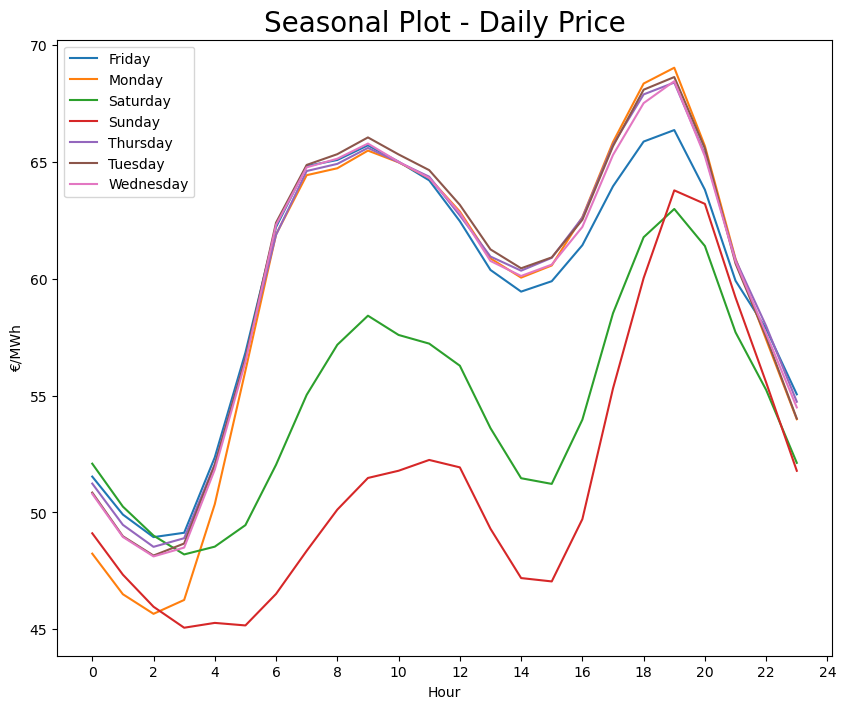

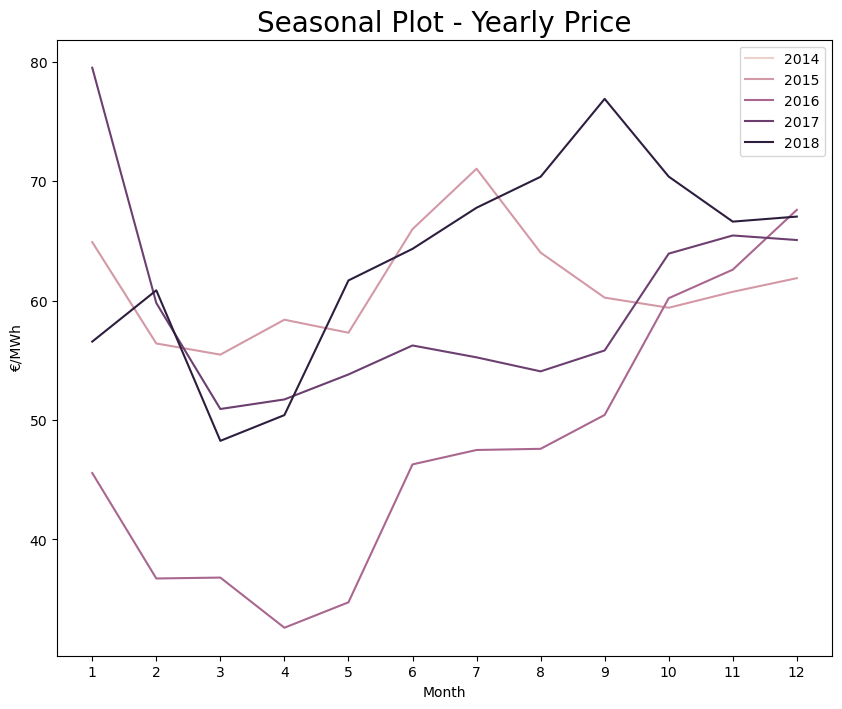

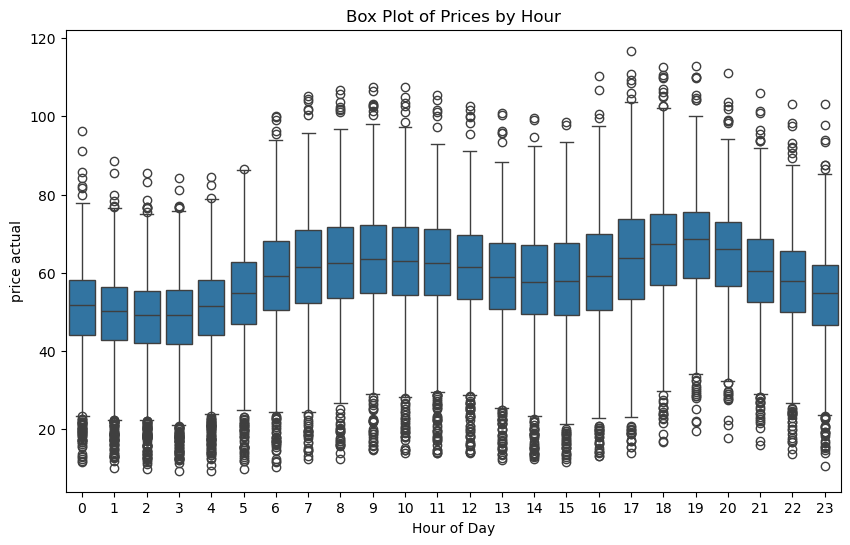

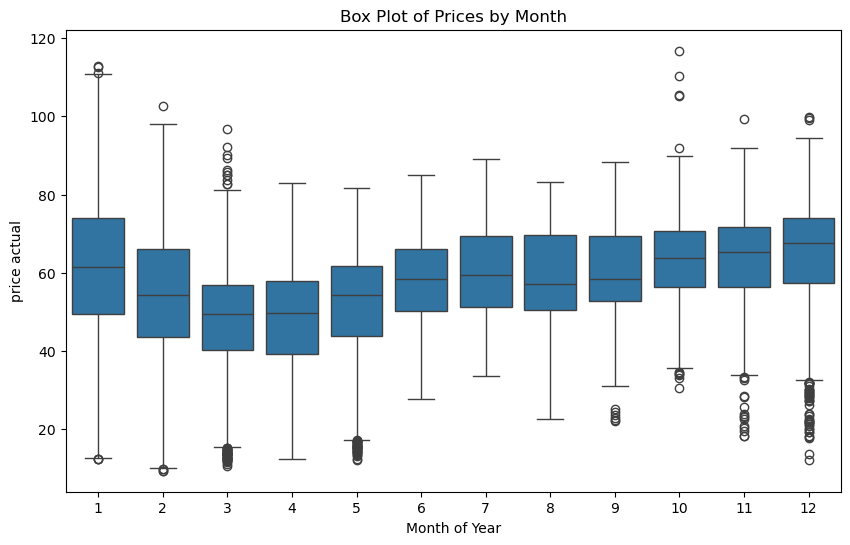

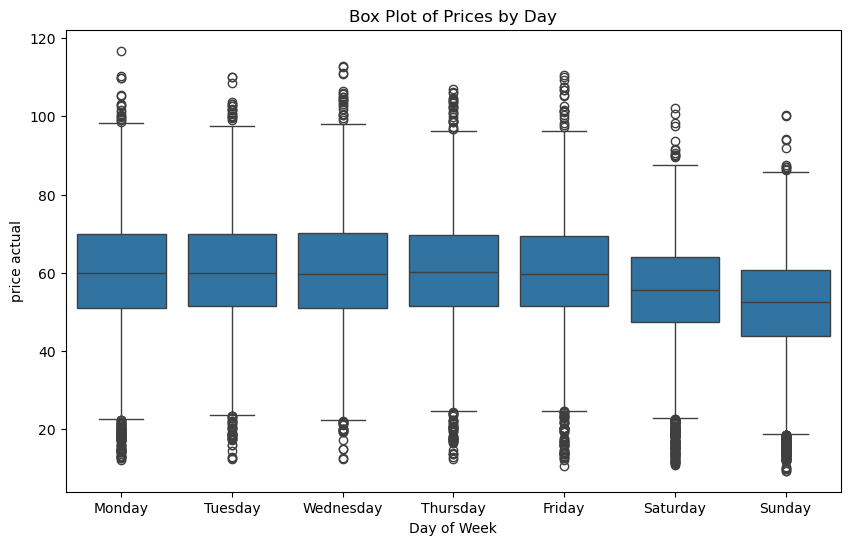

In [42]:
# Seasonal plot — Daily consumption
season_plot_daily_consumption(energy_data_)
season_plot_yearly_consumption(energy_data_)
plot_box_plots_distributions(df_to_plot=energy_data_, distribution='hour')
plot_box_plots_distributions(df_to_plot=energy_data_, distribution='month')
plot_box_plots_distributions(df_to_plot=energy_data_, distribution='day')


#### 5. Visual Exploration: Observations#4

  - There is no distinct trend in the €/MW prices across different years. However, it appears that the first few months of the year (February to May) generally exhibit lower prices.

  - The daily price variations highlight differences in consumption patterns between weekends and weekdays.

  - Prices by hour: higher mean values from 8h-12h and 17h-20h
  - Prices by month: higher mean values in January and December (highest price in last months of year+january)
  - Prices by day: lower on weekends

In [43]:
#Check stationarity and ACF/PACF
check_stationarity(energy_data_['price actual'])


ADF Statistic: -9.147016
p-value: 0.000000
Critical Values:
	1%: -3.431
	5%: -2.862
	10%: -2.567
Stationary


<Figure size 1200x600 with 0 Axes>

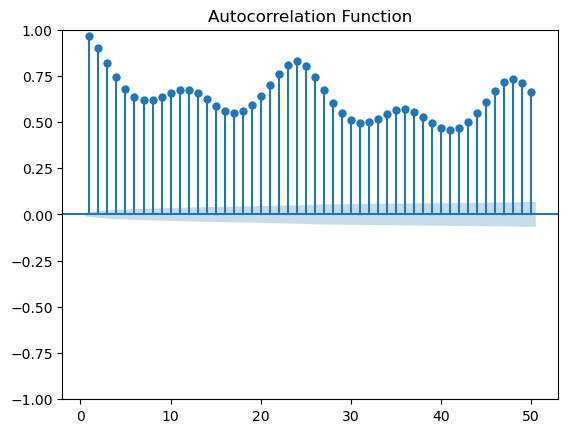

<Figure size 1200x600 with 0 Axes>

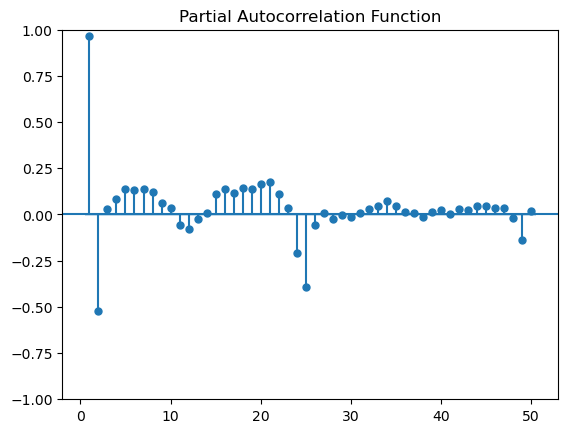

In [44]:
plt.figure(figsize=(12, 6))
plot_acf(energy_data_['price actual'], lags=50, zero=False)
plt.title('Autocorrelation Function')
plt.show()

# PACF Plot
plt.figure(figsize=(12, 6))
plot_pacf(energy_data_['price actual'], lags=50, zero=False)
plt.title('Partial Autocorrelation Function')
plt.show()

#### 5. Visual Exploration: Observations#5
#### ACF/PACF Notes
**"The autocorrelation analysis helps in detecting hidden patterns and seasonality and in checking for randomness"**

Citations extracted from 'Time Series: Interpreting ACF and PACF' notebook (link here:https://www.kaggle.com/code/iamleonie/time-series-interpreting-acf-and-pacf)

**"ACF and PACF assume stationarity of the underlying time series.**
  - Staionarity can be checked by performing an Augmented Dickey-Fuller (ADF) test(...)
      - If the time series is stationary, continue to the next steps.
      - If the time series is not stationary, try differencing the time series and check its stationarity again."

1. Cyclic Pattern: ACF plot shows a strong seasonality in the electricity price data. Peaks ocurring at regular lags (24,48) - it reflets day patterns - current values of price are significantly correlated with past values.

2. PACF plot: t-1 is highly dependent of t price; t-2 has a negative relationship with t. There's also some pikes because of daily seasonality in t-24

PACF values: can be used to see lag features candidates;


In [46]:
energy_data_.to_csv('../data/processed/df_energy.csv')

### 6. Conclusions

- **Feature Distribution**: The different features in our dataset do not follow the same distribution.

- **Intermittency/Zero Values**: Some features shows a high level of intermittency with many zero values - this can have significant implications for model selection.

- **Correlation with Target**: The feature most strongly correlated with the target variable (price actual) is 'price actual forecast', which is expected since the forecast tends to be a predictor of the actual price. Other energy sources (such as fossil-based generation) also show moderate correlations, both positive and negative, with the target.

- **Stationarity and Cyclical Patterns**: The target variable (price actual) exhibits signs of stationarity, along with clear cyclical behavior.

- **Seasonality in Prices**: From the exploratory analysis, we observed distinct seasonal patterns in the target value:

  - **Daily Seasonality**: Prices tend to spike during the evening (around 20:00).
  - **Weekly Seasonality**: Weekends generally exhibit lower electricity prices compared to weekdays.
  - **Monthly Seasonalit**: Prices tend to be higher in the winter months (December, January) and lower in the early spring (February to May).

**NOTE**: another approach to do EDA is using a low-code solution (ydata profiling)

In [48]:
from ydata_profiling import ProfileReport
profile = ProfileReport(energy_data_, title="Pandas Profiling Report", explorative=True)

# Display the report in the notebook
profile.to_notebook_iframe()
profile.to_file("report.html")

Render HTML: 100%|██████████| 1/1 [00:23<00:00, 23.20s/it]


Export report to file: 100%|██████████| 1/1 [00:00<00:00,  5.37it/s]
